In [1]:
%pip -q install gtbook # also installs latest gtsam pre-release

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.8/21.8 MB 21.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.9/79.9 MB 7.1 MB/s eta 0:00:00


In [2]:
%pip install open3d

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 399.7/399.7 MB 3.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 19.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 139.8/139.8 kB 7.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 228.0/228.0 kB 5.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.3/2.3 MB 12.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 12.0 MB/s eta 0:00:00
  Attempting uninstall: widgetsnbextension
    Found existing installation: widgetsnbextension 3.6.10
    Uninstalling widgetsnbextension-3.6.10:
      Successfully uninstalled widgetsnbextension-3.6.10
  Attempting uninstall: werkzeug
    Found existing installation: Werkzeug 3.1.3
    Uninstalling Werkzeug-3.1.3:
      Successfully uninstalled Werkzeug-3.1.3
  Attempting uninstall: ipywidgets
    Found existing installation: ipywidgets 7.7.1
    Uninstalling ipywidgets-7.7.1:
      Successfully uninstalled ipywidgets-7.7.

In [3]:
%pip install gtsam

In [4]:
import os
import numpy as np
import cv2
import gtsam
import gtsam.utils.plot as gtsam_plot
import math
import plotly.graph_objects as go
import itertools
import pickle
import matplotlib.pyplot as plt
import scipy
import copy
import tqdm
import open3d as o3d
from mpl_toolkits.mplot3d import Axes3D
from mpl_toolkits.mplot3d.art3d import Poly3DCollection

In [5]:
data_dir = "/content/sample_data/buddha_images/"
image_list = sorted(os.listdir(data_dir))
N = len(image_list)
Images = [cv2.cvtColor(cv2.imread(os.path.join(data_dir, filename)), cv2.COLOR_BGR2GRAY) for filename in image_list]

In [6]:
h, w = Images[0].shape[:2]
f = 1300
K = np.array([[f, 0, w/2],
              [0, f, h/2],
              [0, 0, 1]], dtype=np.float32)

In [7]:
def locate_feature_points(image1, image2):
    # Initialize SIFT for keypoint detection and description
    sift_detector = cv2.SIFT_create()
    keypoints1, descriptors1 = sift_detector.detectAndCompute(image1, None)
    keypoints2, descriptors2 = sift_detector.detectAndCompute(image2, None)

    # Use BFMatcher to find matches between descriptors
    bf_matcher = cv2.BFMatcher()
    raw_matches = bf_matcher.knnMatch(descriptors1, descriptors2, k=2)

    # Apply ratio test to keep good matches
    reliable_matches = [m for m, n in raw_matches if m.distance < 0.75 * n.distance]
    points1 = np.float32([keypoints1[m.queryIdx].pt for m in reliable_matches]).reshape(-1, 1, 2)
    points2 = np.float32([keypoints2[m.trainIdx].pt for m in reliable_matches]).reshape(-1, 1, 2)
    return points1, points2

In [8]:
def perform_nms(detected_keypoints):
    height, width = Images[0].shape[:2]
    mask_output = np.zeros((height, width), dtype=np.uint8)

    responses = np.array([kp.response for kp in detected_keypoints])
    sorted_indices = np.flip(np.argsort(responses))

    sorted_points = np.rint([kp.pt for kp in detected_keypoints])[sorted_indices].astype(int)

    nms_keypoints = []
    for point, i in zip(sorted_points, sorted_indices):
        if mask_output[point[1], point[0]] == 0:
            nms_keypoints.append(i)
            cv2.circle(mask_output, tuple(point), 2, 255, -1)
    return nms_keypoints

saved_keypoints, saved_descriptors = None, None
sift_descriptor = cv2.SIFT_create(1000, nOctaveLayers=3, contrastThreshold=0.04)
bf_matcher = cv2.BFMatcher(cv2.NORM_L2)

In [9]:
def match_and_visualize(img1, img2, index1, index2):
    global saved_keypoints, saved_descriptors

    if saved_keypoints is None or saved_descriptors is None:
        keypoints1, descriptors1 = sift_descriptor.detectAndCompute(img1, None)
        mask1 = perform_nms(keypoints1)
        keypoints1 = np.array(keypoints1)[mask1]
        descriptors1 = np.array(descriptors1)[mask1]
    else:
        keypoints1, descriptors1 = saved_keypoints, saved_descriptors

    keypoints2, descriptors2 = sift_descriptor.detectAndCompute(img2, None)
    mask2 = perform_nms(keypoints2)
    keypoints2 = np.array(keypoints2)[mask2]
    descriptors2 = np.array(descriptors2)[mask2]

    saved_keypoints, saved_descriptors = keypoints2, descriptors2
    knn_matches = bf_matcher.knnMatch(descriptors1, descriptors2, k=2)
    reliable_matches = [m for m, n in knn_matches if m.distance < 0.75 * n.distance]

    img1_pts = np.float32([keypoints1[m.queryIdx].pt for m in reliable_matches])
    img2_pts = np.float32([keypoints2[m.trainIdx].pt for m in reliable_matches])
    display_epipolar_lines(img1, img2, img1_pts, img2_pts)

    return img1_pts, img2_pts


In [10]:
def display_epipolar_lines(img1, img2, points1, points2):
    src_pts, dst_pts = locate_feature_points(img1, img2)
    img1_features = cv2.drawKeypoints(img1, [cv2.KeyPoint(x, y, 5) for (x, y) in src_pts[:, 0]], None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
    img2_features = cv2.drawKeypoints(img2, [cv2.KeyPoint(x, y, 5) for (x, y) in dst_pts[:, 0]], None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

    plt.figure(figsize=(16, 9))
    plt.subplot(1, 2, 1)
    plt.imshow(img1_features, cmap='gray')
    plt.title('Image 1 with Key Points')
    plt.subplot(1, 2, 2)
    plt.imshow(img2_features, cmap='gray')
    plt.title('Image 2 with Key Points')
    plt.show()

    F, mask = cv2.findFundamentalMat(points1, points2, cv2.FM_RANSAC)
    epilines1 = cv2.computeCorrespondEpilines(points2, 2, F).reshape(-1, 3)
    epilines2 = cv2.computeCorrespondEpilines(points1, 1, F).reshape(-1, 3)

    img1_lines, img2_lines = img1_features.copy(), img2_features.copy()
    for line, pt1, pt2 in zip(epilines1, points1.astype(int), points2.astype(int)):
        color = tuple(np.random.randint(0, 255, 3).tolist())
        x0, y0 = map(int, [0, -line[2] / line[1]])
        x1, y1 = map(int, [img1.shape[1], -(line[2] + line[0] * img1.shape[1]) / line[1]])
        img2_lines = cv2.line(img2_lines, (x0, y0), (x1, y1), color, 1)
        img1_lines = cv2.circle(img1_lines, tuple(pt1), 5, color, -1)
        img1_lines = cv2.line(img1_lines, (x0, y0), (x1, y1), color, 1)

    plt.figure(figsize=(16, 9))
    plt.subplot(1, 2, 1)
    plt.imshow(img1_lines, cmap='gray')
    plt.title('Epipolar Lines on Image 1')
    plt.subplot(1, 2, 2)
    plt.imshow(img2_lines, cmap='gray')
    plt.title('Epipolar Lines on Image 2')
    plt.show()

In [11]:
def compute_essential_matrix(q1, q2):
    E, mask = cv2.findEssentialMat(q1, q2, K, cv2.RANSAC, 0.999, 1.0)
    q1, q2 = q1[mask.ravel() == 1], q2[mask.ravel() == 1]
    return E, q1, q2, mask

In [12]:
def calculate_transformation_matrix(rotation_matrix, trans_vec):
    transform_mat = np.eye(4, dtype=np.float64)
    transform_mat[:3, :3] = rotation_matrix
    transform_mat[:3, 3] = trans_vec.ravel() if trans_vec.ndim == 1 else trans_vec
    return transform_mat

In [13]:
def get_proj_matrix(T):
    return K @ np.linalg.inv(T)[:3, :]

In [14]:
def triangulate_points(q1, q2, proj_matrix1, proj_matrix2):
    points_4d = cv2.triangulatePoints(proj_matrix1, proj_matrix2, q1.T, q2.T)
    points_3d = (points_4d[:3, :] / points_4d[3, :]).T
    valid_mask = points_3d[:, 2] > 0
    return points_3d[valid_mask], q1[valid_mask], q2[valid_mask]

In [15]:
class Point3D:
    def __init__(self, coordinates, origins):
        self.coordinates = np.array(coordinates, dtype=np.float32)
        self.origins = origins

def locate_3d_point(point_cloud, target_point, frame_index):
    for existing_point in point_cloud:
        try:
            if np.array_equal(target_point.origins[frame_index], existing_point.origins[frame_index]):
                return True, existing_point
        except KeyError:
            continue
    return False, None

In [16]:
def extend_point_cloud(point_cloud, frame_index, points_3d, keypoints1, keypoints2):
    for i, point_3d in enumerate(points_3d):
        new_point = Point3D(point_3d, {frame_index: keypoints1[i], frame_index + 1: keypoints2[i]})
        found, existing_point = locate_3d_point(point_cloud, new_point, frame_index)

        if found:
            existing_point.origins[frame_index + 1] = keypoints2[i]
        else:
            point_cloud.append(new_point)

In [17]:
def map_keypoints_to_point_cloud(frame_index, previous_keypoints, point_cloud, keypoints1):
    matched_keypoints_2d, matched_points_3d, matched_indices = [], [], []

    for i, keypoint in enumerate(keypoints1):
        for prev_keypoint in previous_keypoints:
            if np.array_equal(keypoint, prev_keypoint):
                matched_keypoints_2d.append(keypoint)
                matched_indices.append(i)

    for i, keypoint_2d in enumerate(matched_keypoints_2d):
        for point_3d in point_cloud:
            try:
                if np.array_equal(keypoint_2d, point_3d.origins[frame_index]):
                    matched_points_3d.append(point_3d.coordinates)
                    break
            except KeyError:
                continue

    return np.array(matched_keypoints_2d, dtype=np.float32), np.array(matched_points_3d, dtype=np.float32), matched_indices


#Epipolar Lines

Image 0 and 1


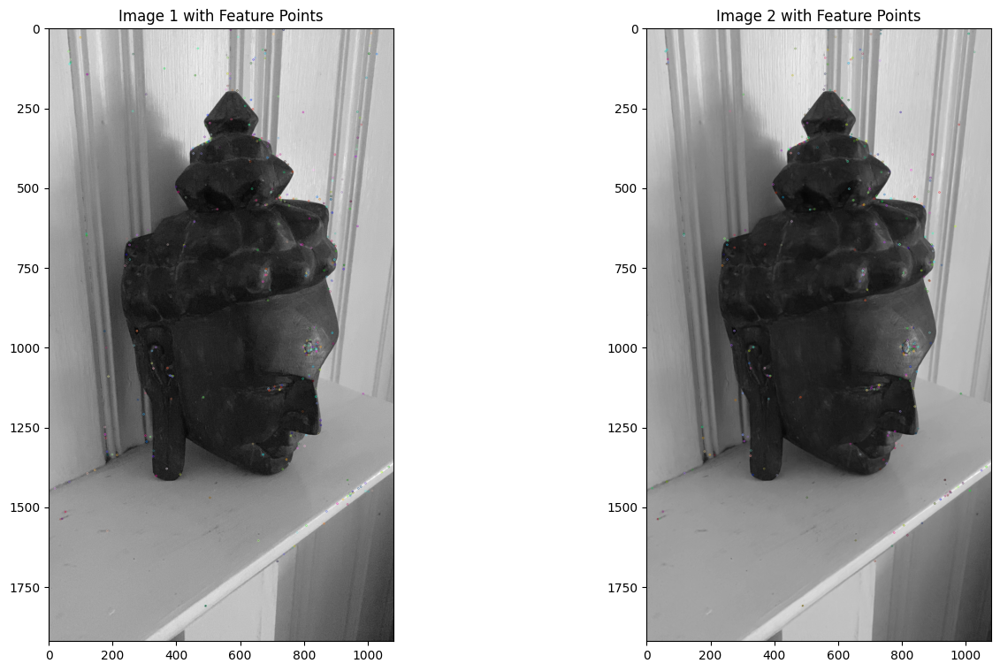

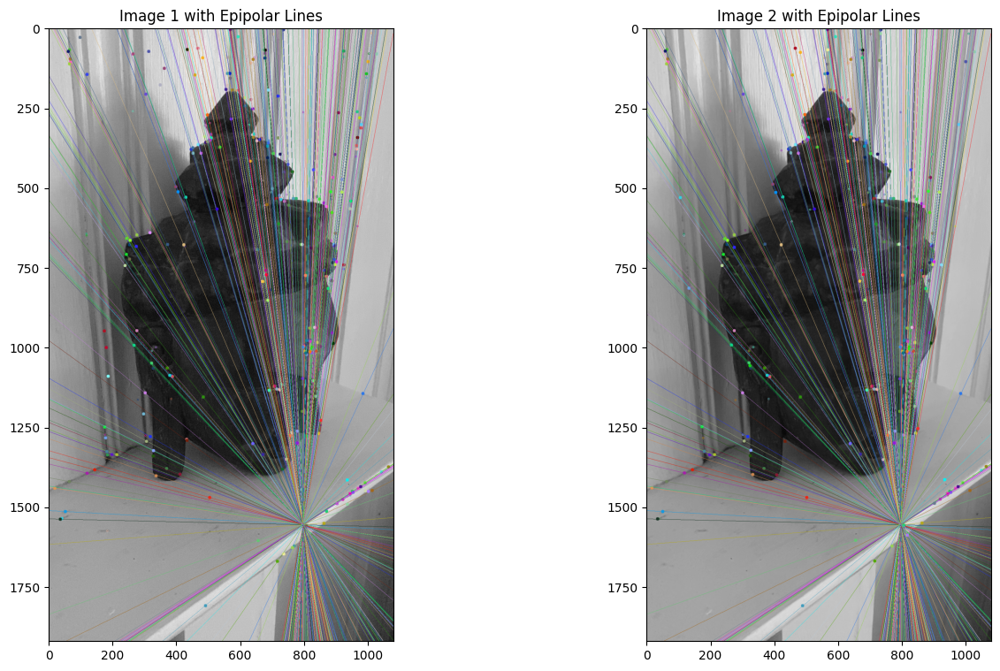

In [18]:
camera_positions = []
print("Processing images 0 and 1")
first_image, second_image = Images[0], Images[1]
camera_positions = [None, None]
keypoints1, keypoints2 = match_and_visualize(first_image, second_image, 0, 1)
essential_matrix, keypoints1, keypoints2, mask = compute_essential_matrix(keypoints1, keypoints2)
_, rotation, translation, _ = cv2.recoverPose(essential_matrix, keypoints1, keypoints2, K)
transformation_matrix = calculate_transformation_matrix(rotation, translation)
camera_positions[0] = np.eye(4)
camera_positions[1] = np.linalg.inv(transformation_matrix)

proj_matrix1 = get_proj_matrix(np.eye(4))
proj_matrix2 = get_proj_matrix(camera_positions[1])

points_3d, keypoints1, keypoints2 = triangulate_points(keypoints1, keypoints2, proj_matrix1, proj_matrix2)

point_cloud = [Point3D(point, {0: keypoints1[i], 1: keypoints2[i]}) for i, point in enumerate(points_3d)]
prev_keypoints = keypoints2

for i in range(1, N-2):
    print(f"Processing images {i} and {i+1}")
    img1, img2 = Images[i], Images[i+1]
    keypoints1, keypoints2 = match_and_visualize(img1, img2, i, i+1)
    essential_matrix, keypoints1, keypoints2, mask = compute_essential_matrix(keypoints1, keypoints2)
    matched_2d_img1, matched_3d_points, matched_indices = map_keypoints_to_point_cloud(i, prev_keypoints, point_cloud, keypoints1)
    matched_2d_img2 = keypoints2[matched_indices]
    success, rotation_vector, translation_vector, _ = cv2.solvePnPRansac(matched_3d_points, matched_2d_img2, K, None)

    if success:
        rotation_matrix, _ = cv2.Rodrigues(rotation_vector)
    current_transform = calculate_transformation_matrix(rotation_matrix, translation_vector)
    camera_positions.append(np.linalg.inv(current_transform))

    proj_matrix1 = get_proj_matrix(camera_positions[i])
    proj_matrix2 = get_proj_matrix(camera_positions[i+1])
    new_points_3d, keypoints1, keypoints2 = triangulate_points(keypoints1, keypoints2, proj_matrix1, proj_matrix2)
    extend_point_cloud(point_cloud, i, new_points_3d, keypoints1, keypoints2)
    prev_keypoints = keypoints2

Image 1 and 2


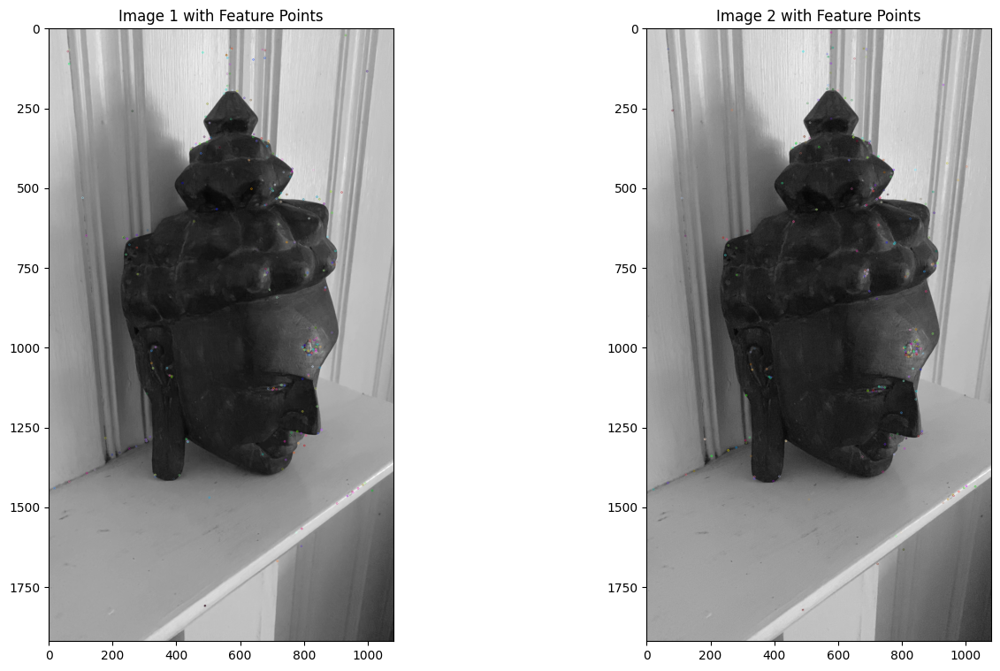

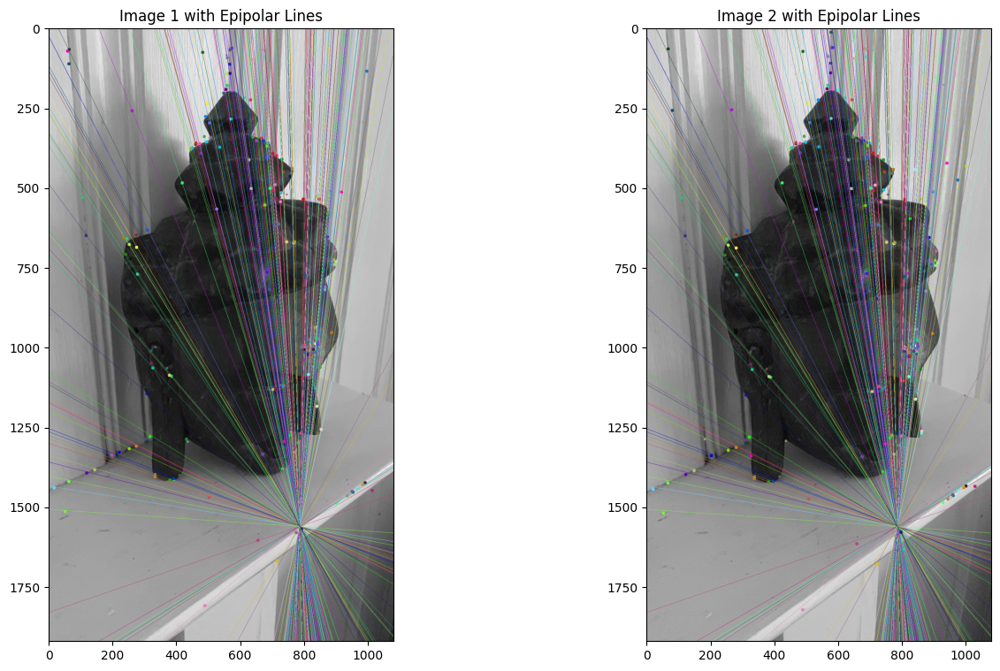

Image 2 and 3


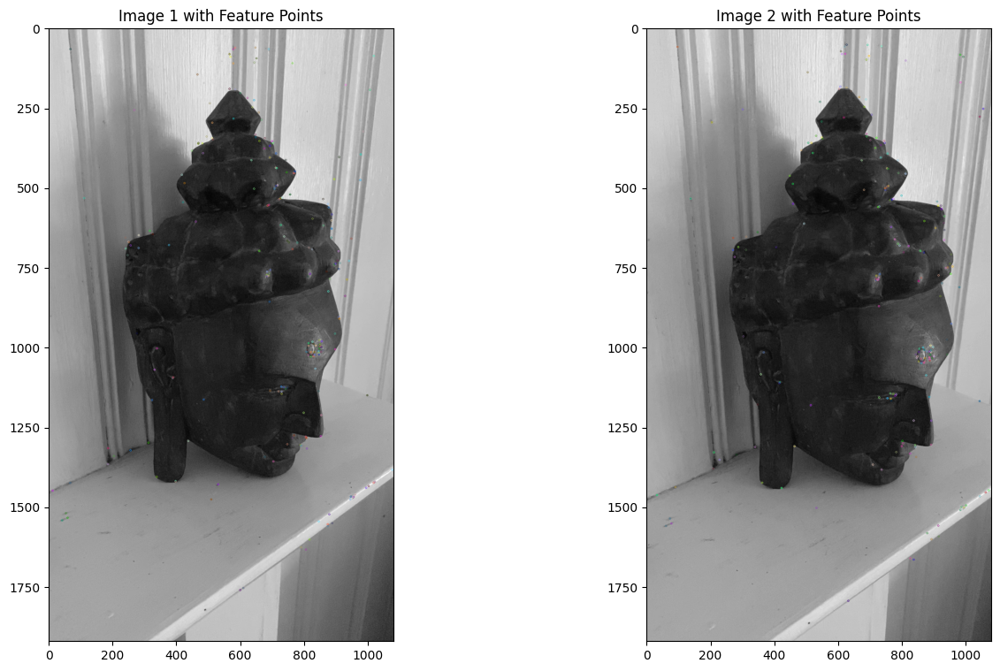

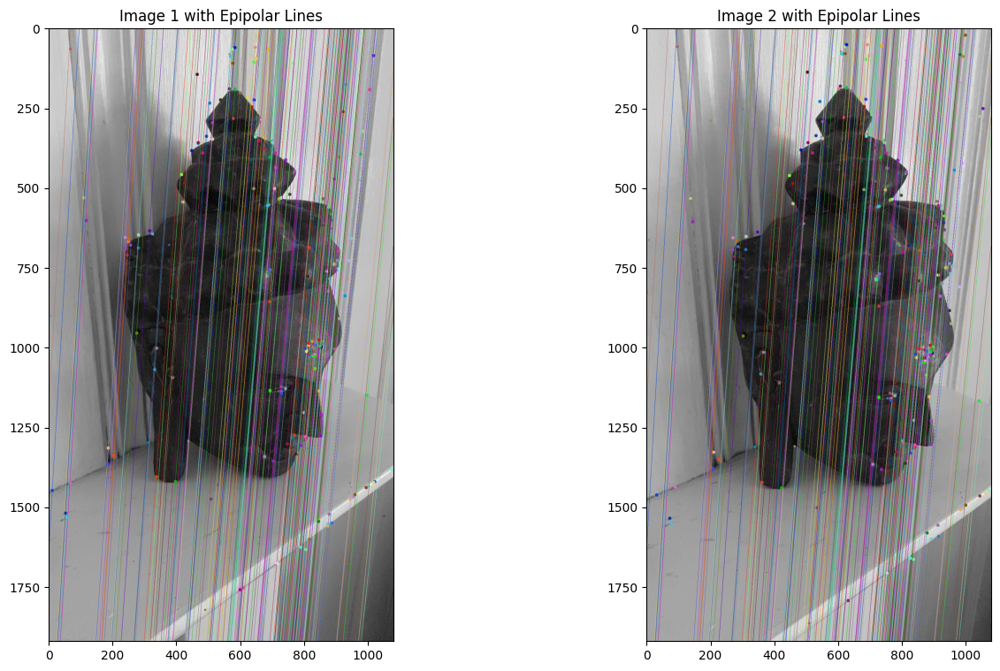

Image 3 and 4


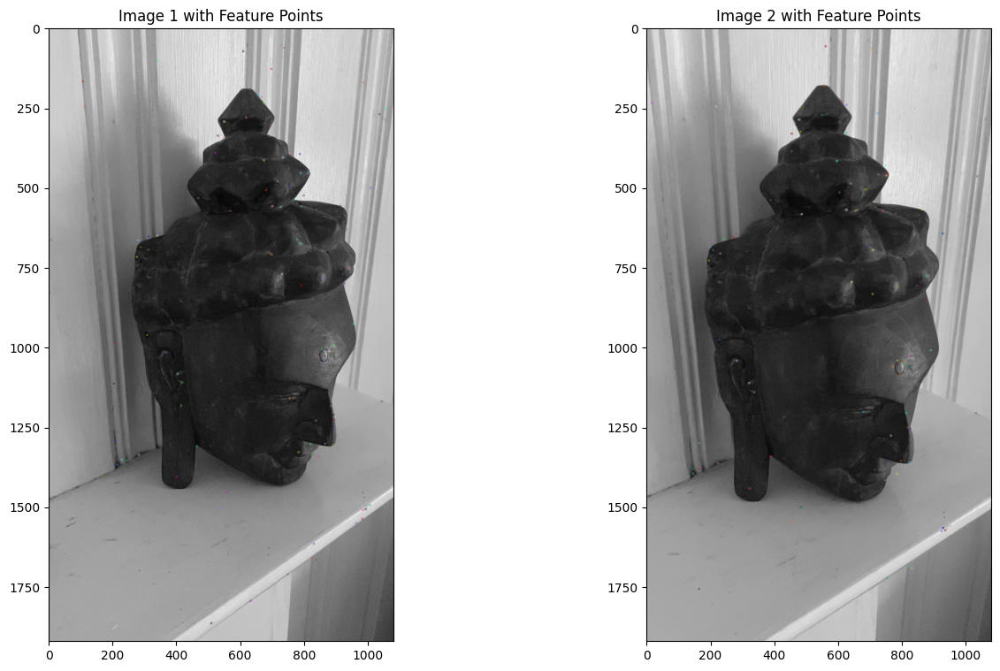

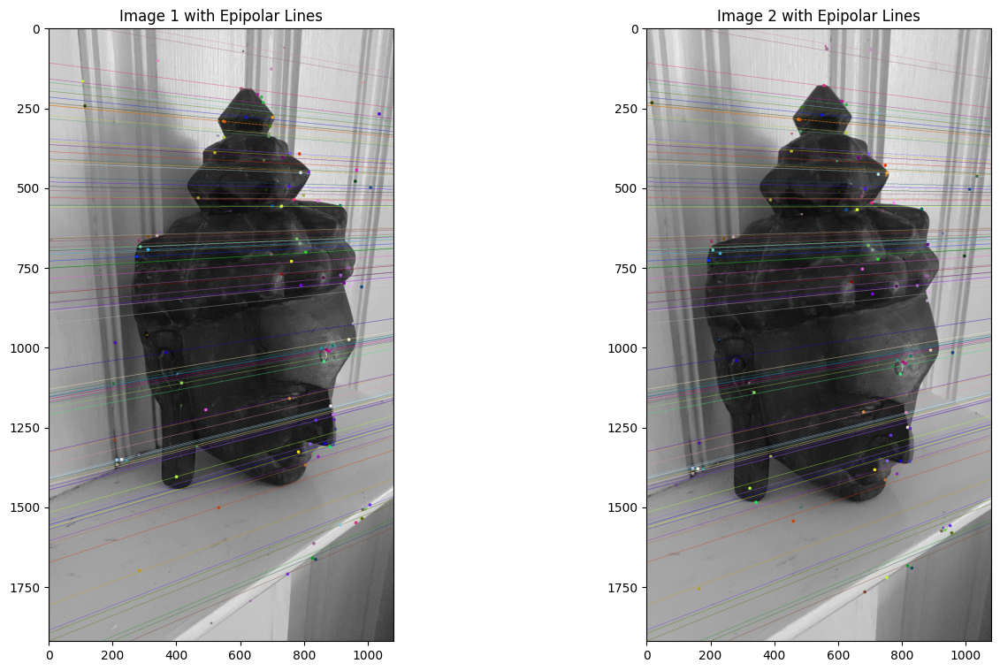

Image 4 and 5


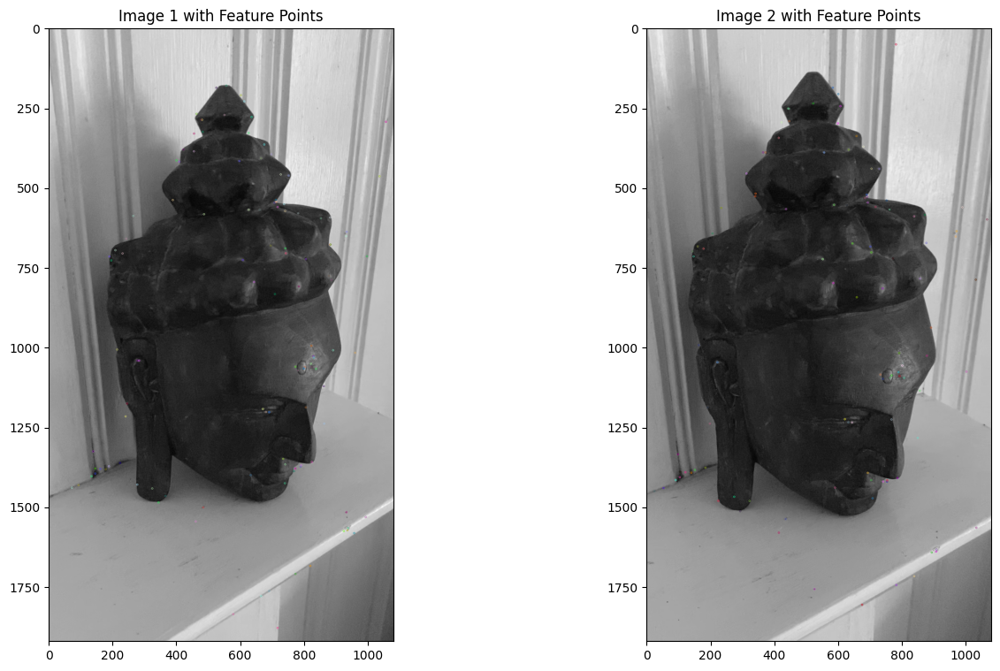

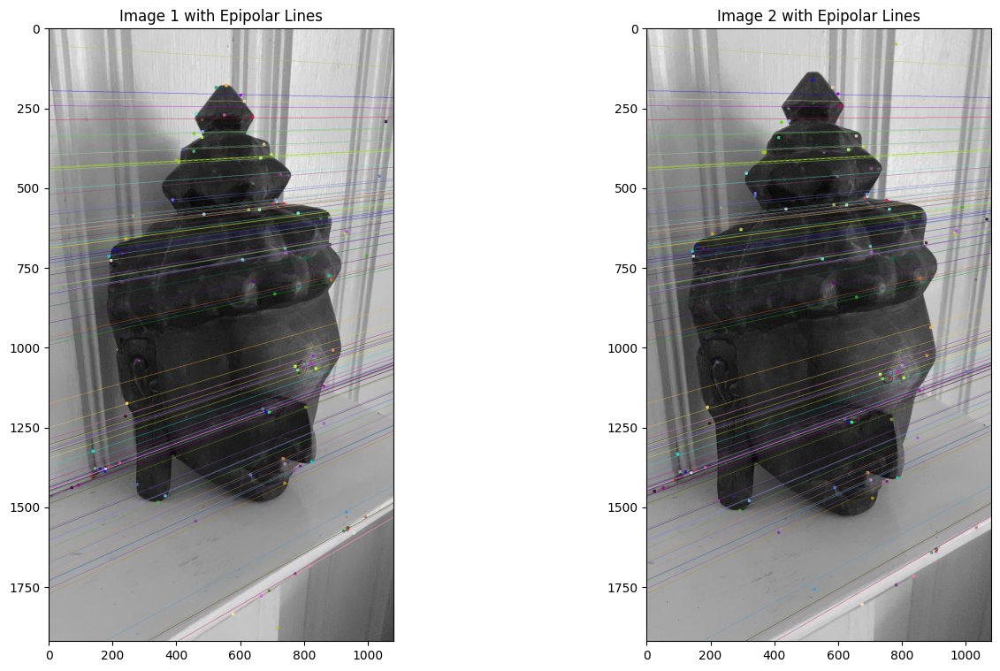

Image 5 and 6


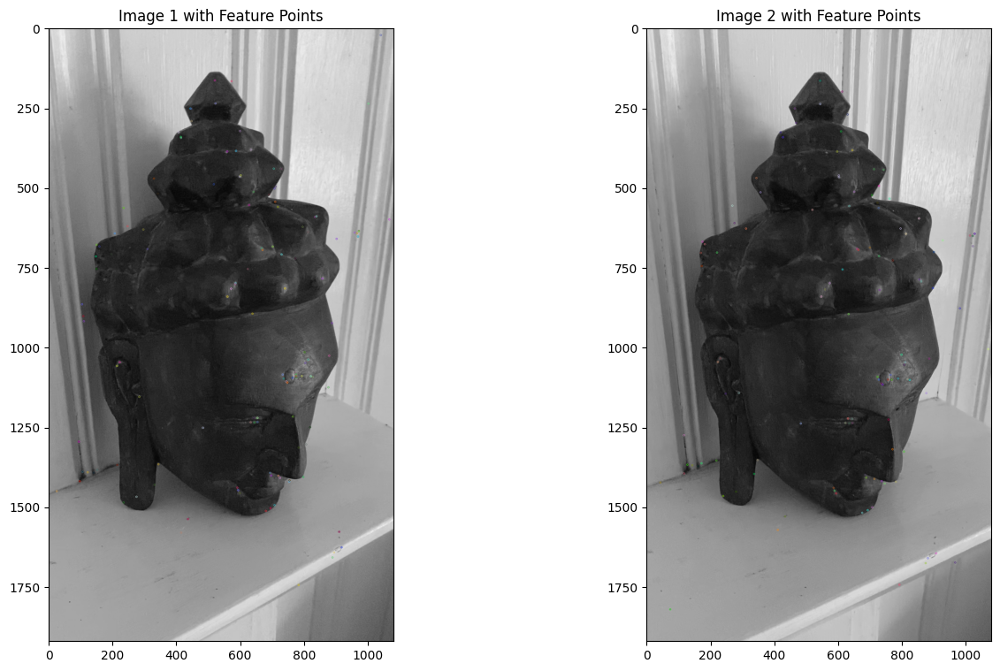

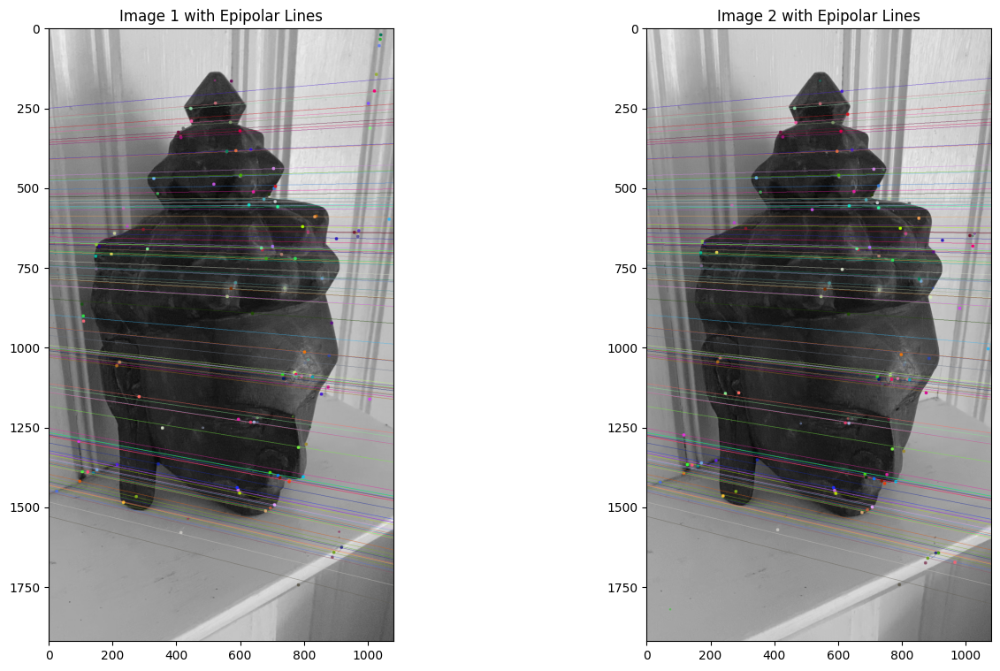

Image 6 and 7


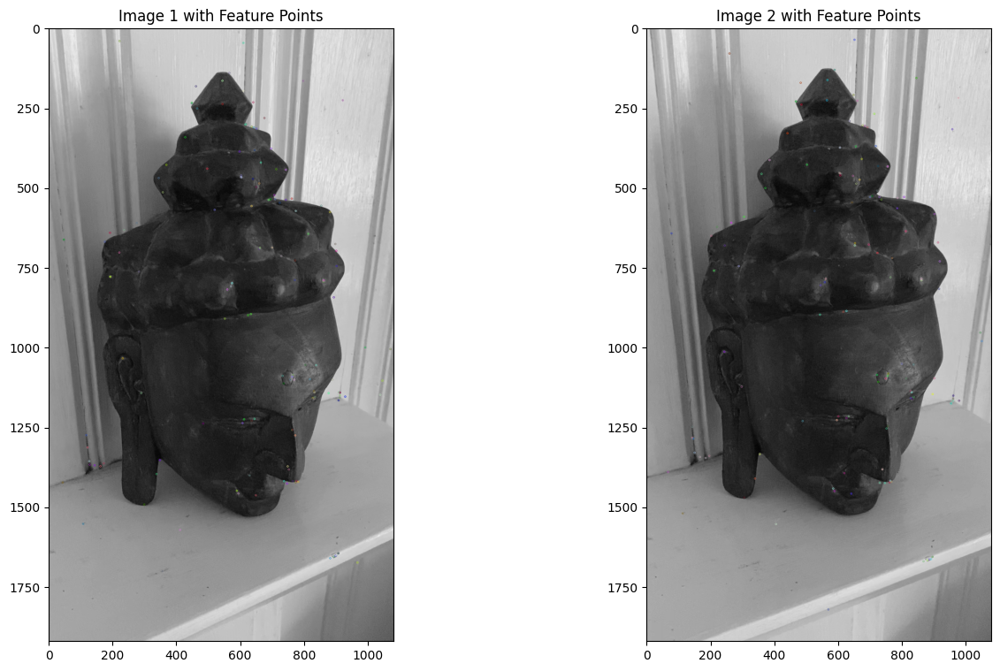

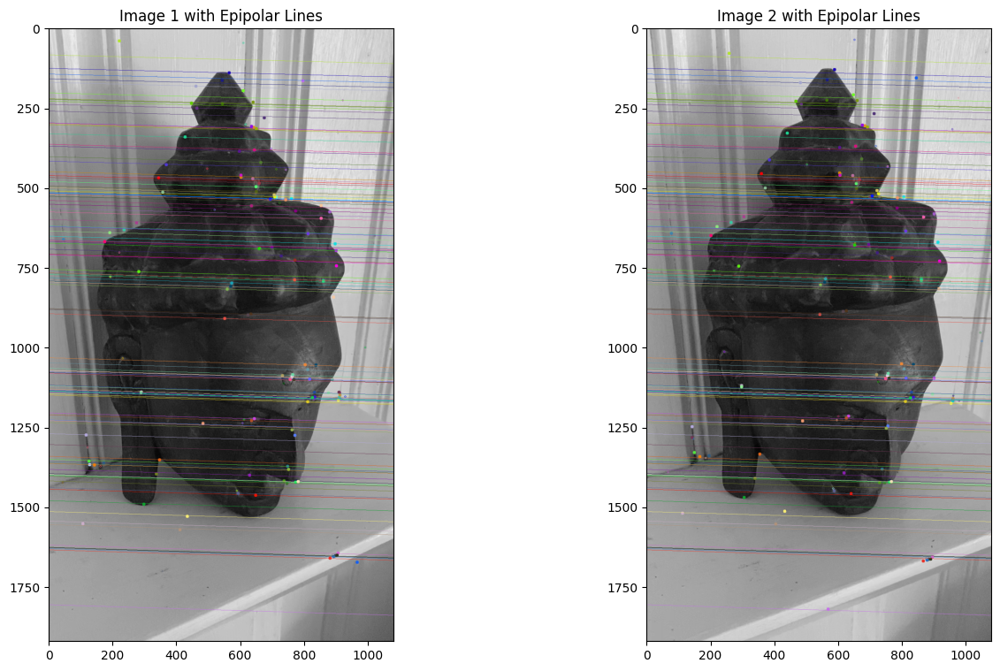

Image 7 and 8


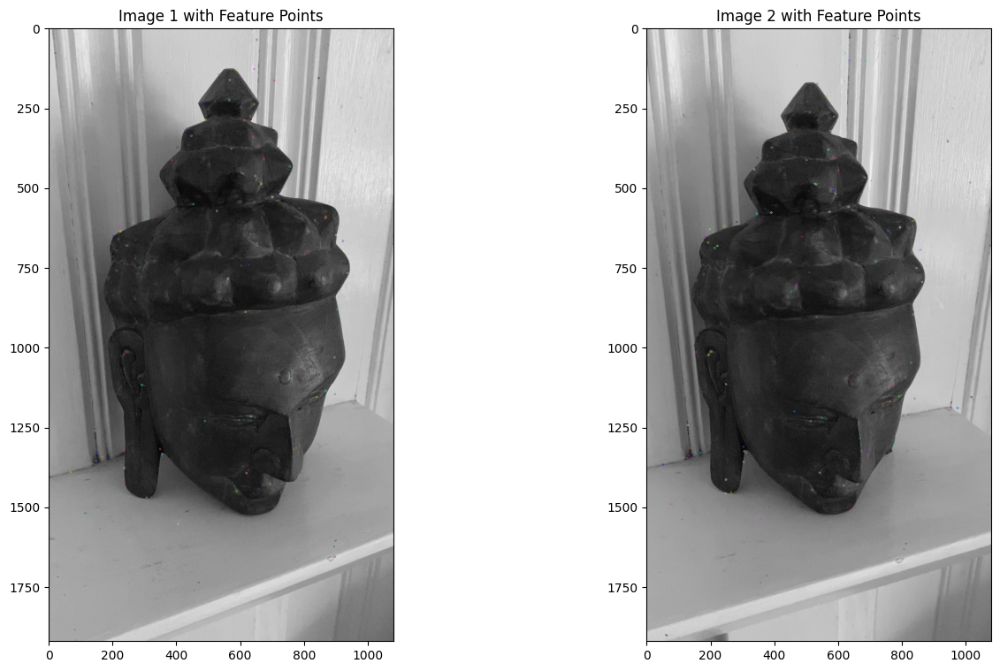

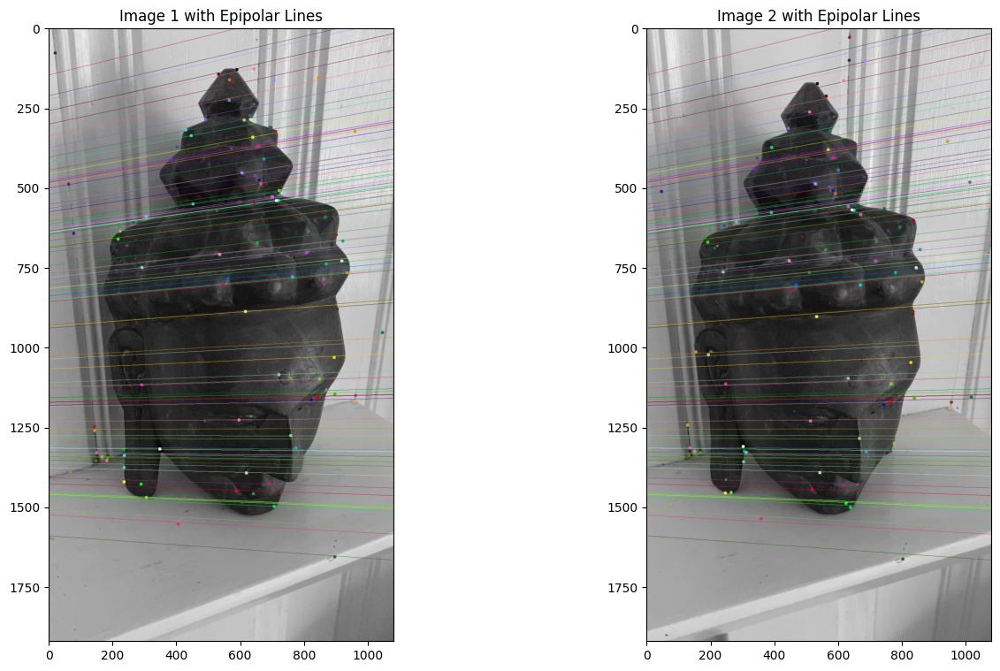

Image 8 and 9


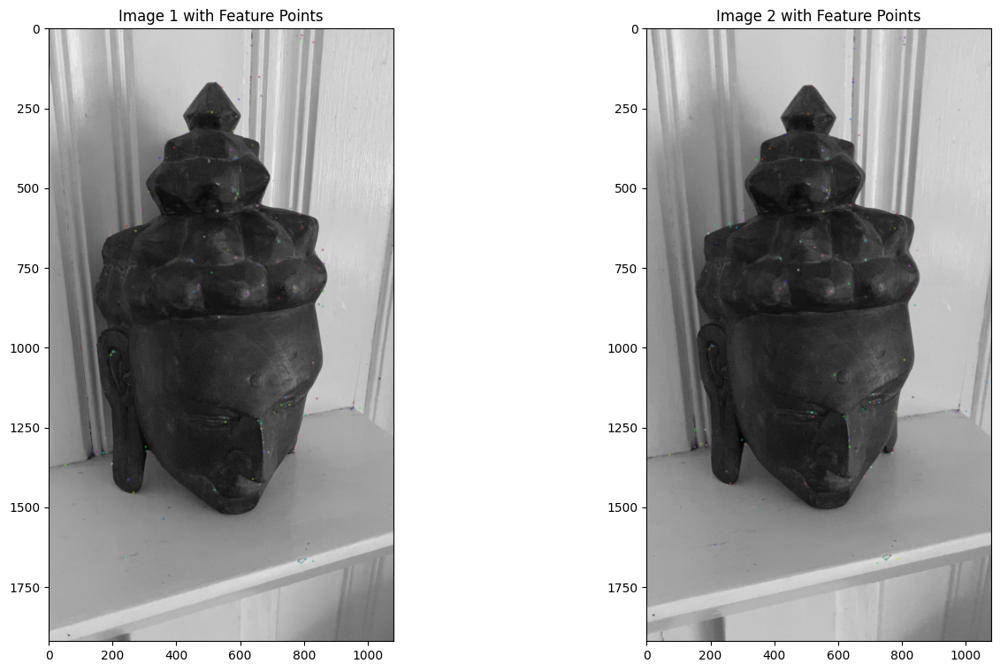

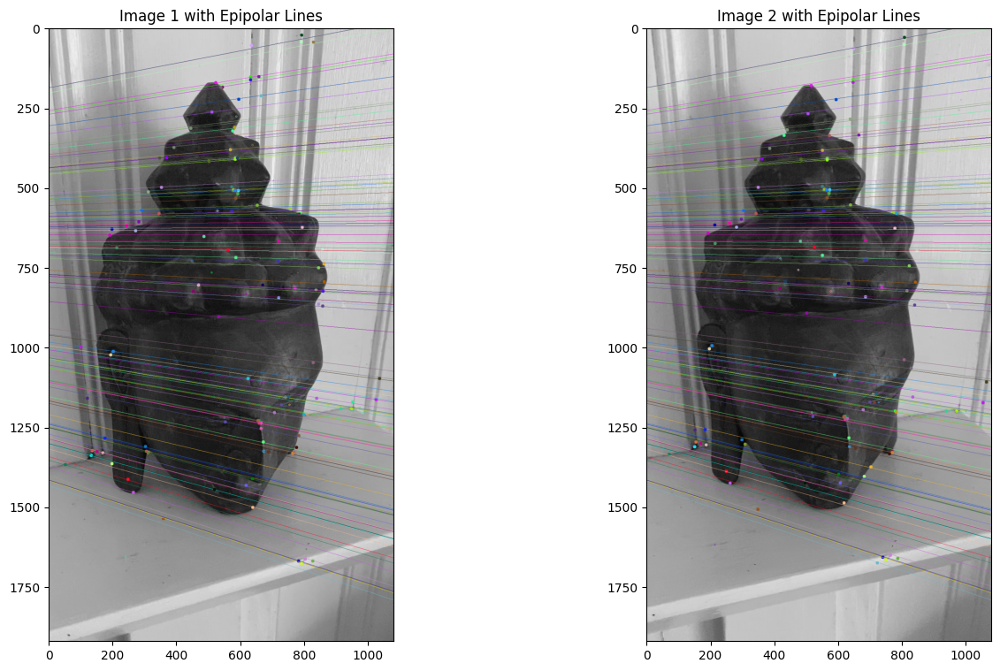

Image 9 and 10


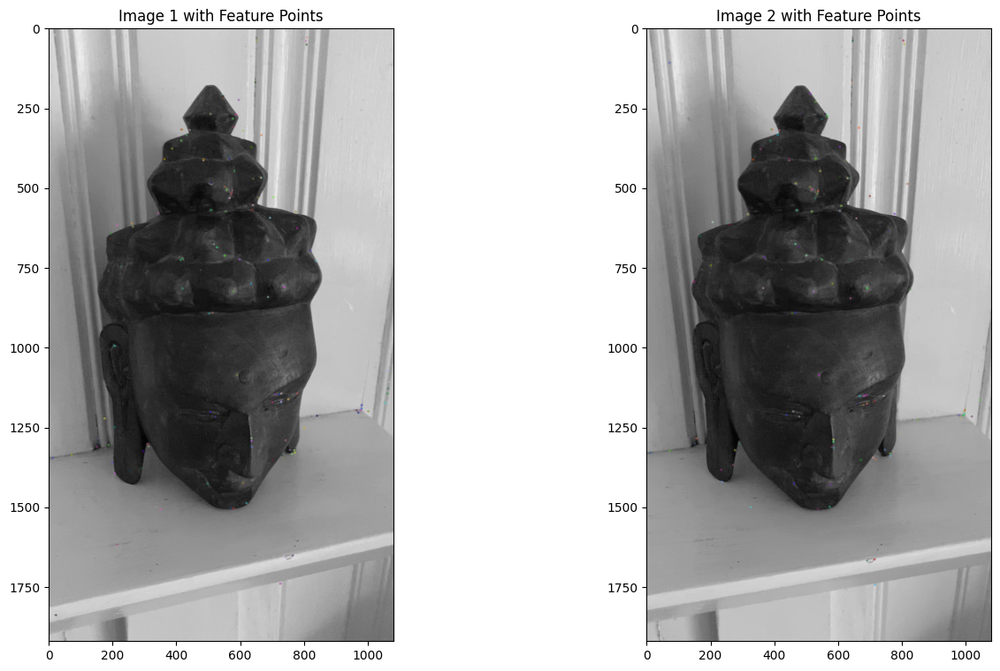

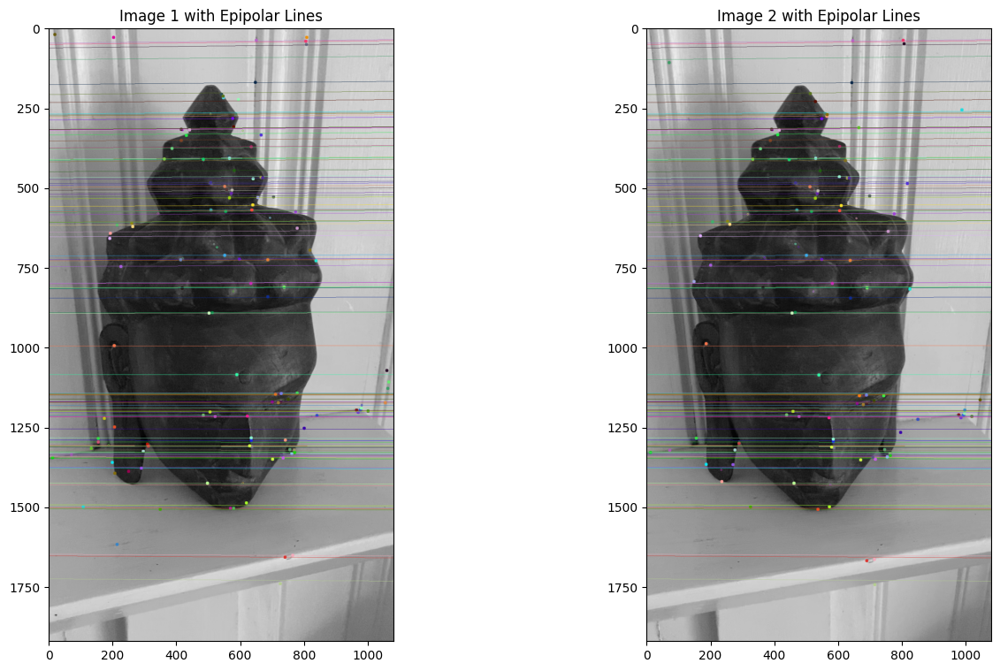

Image 10 and 11


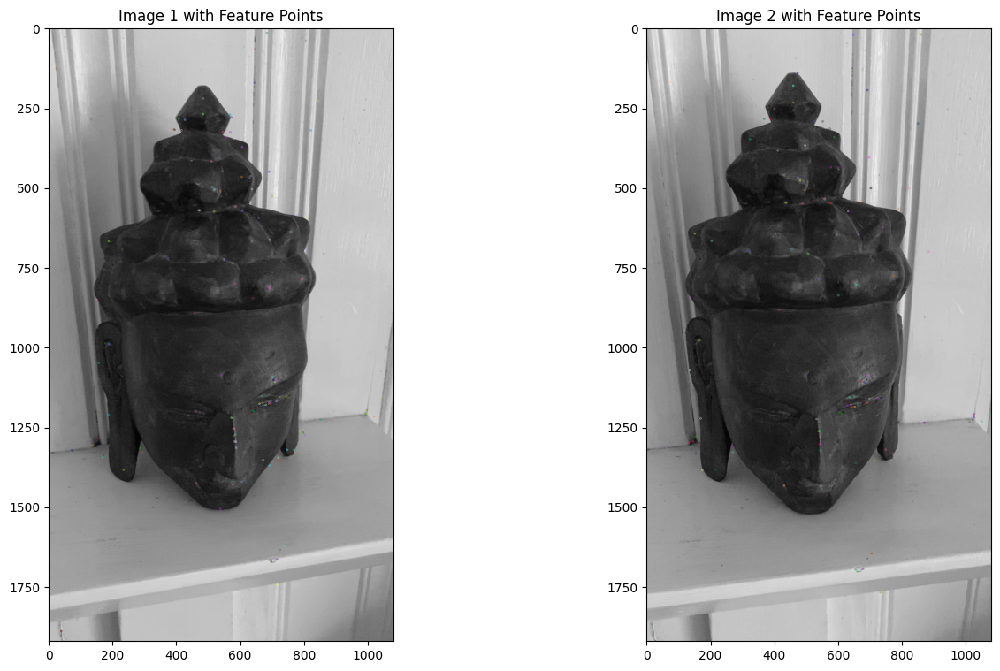

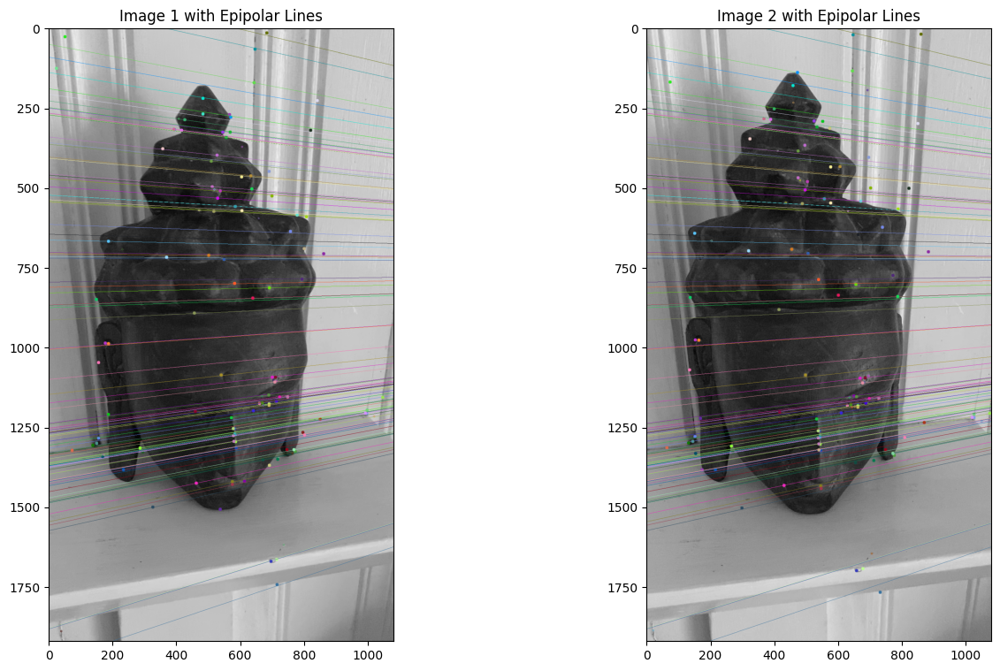

Image 11 and 12


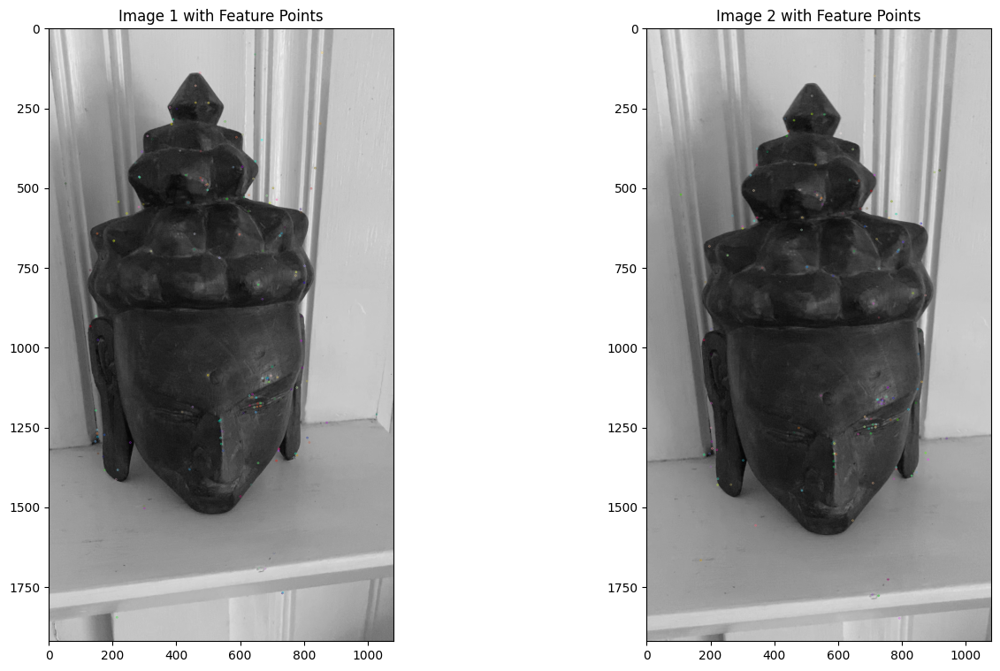

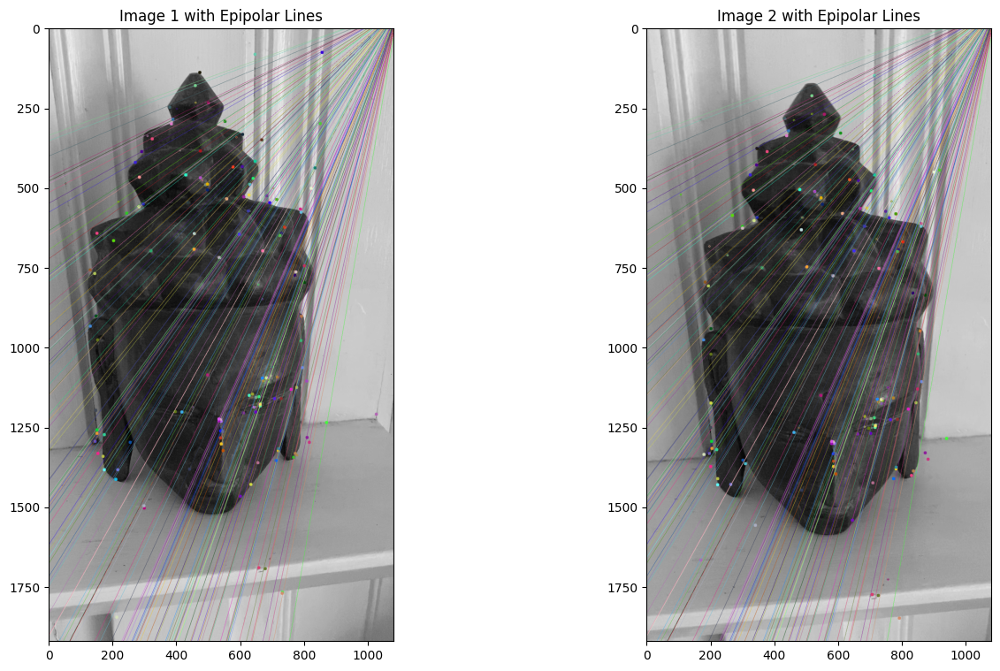

Image 12 and 13


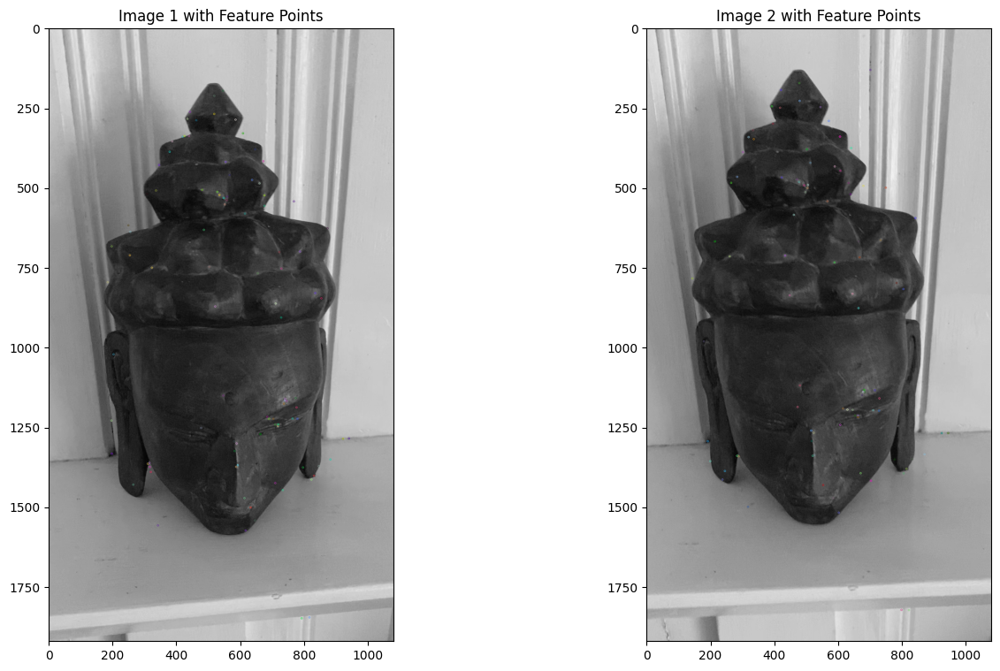

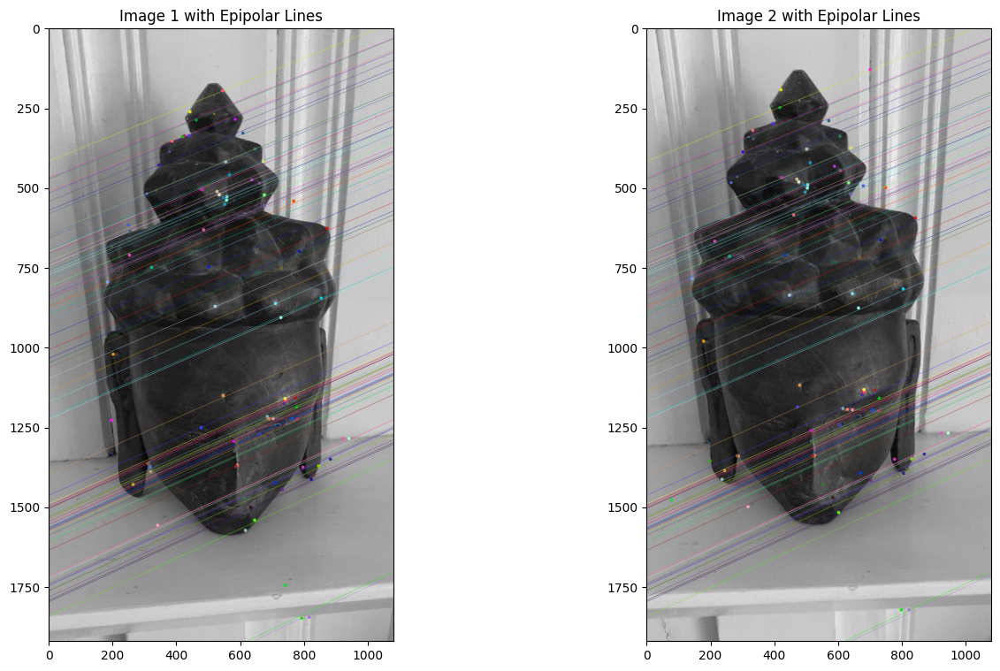

Image 13 and 14


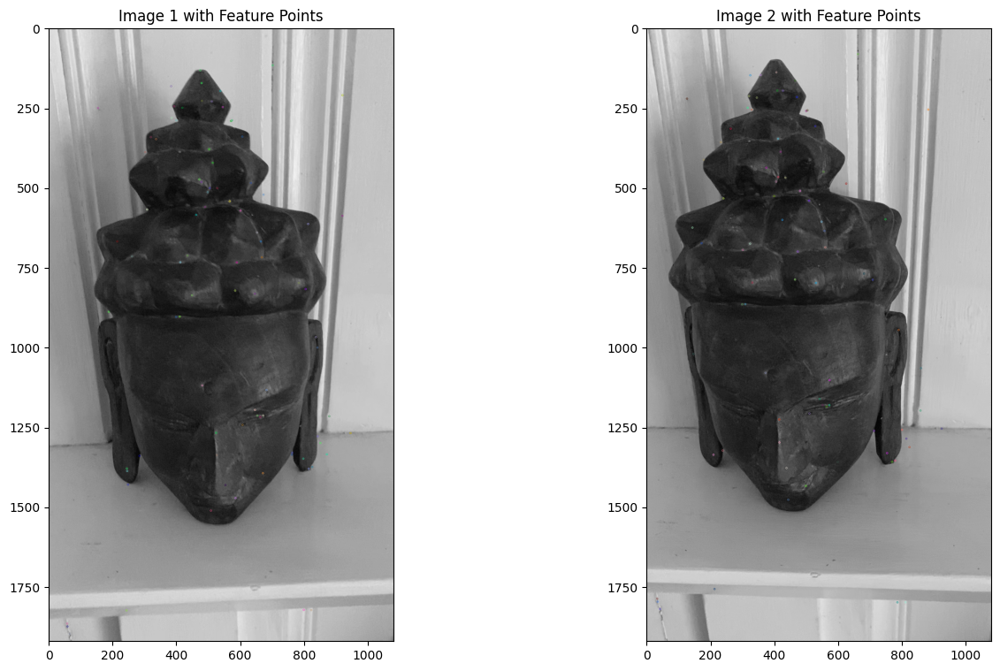

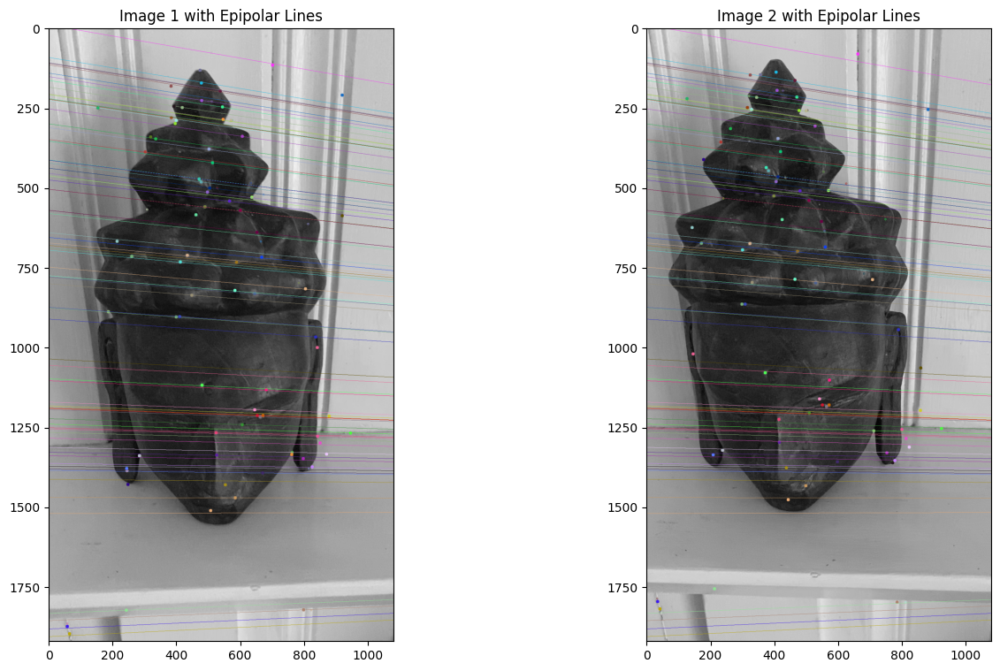

Image 14 and 15


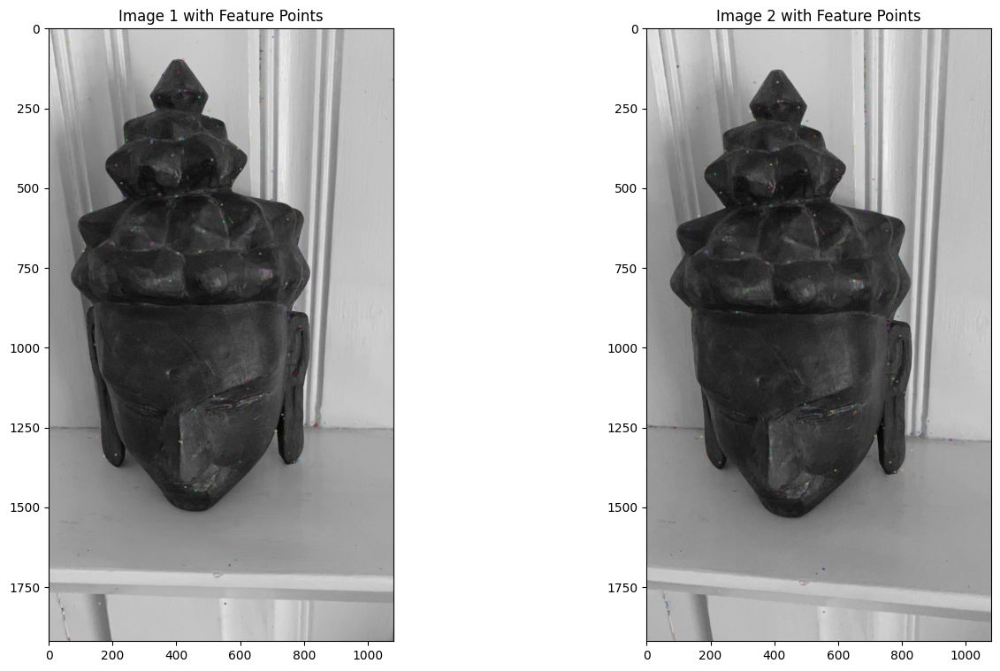

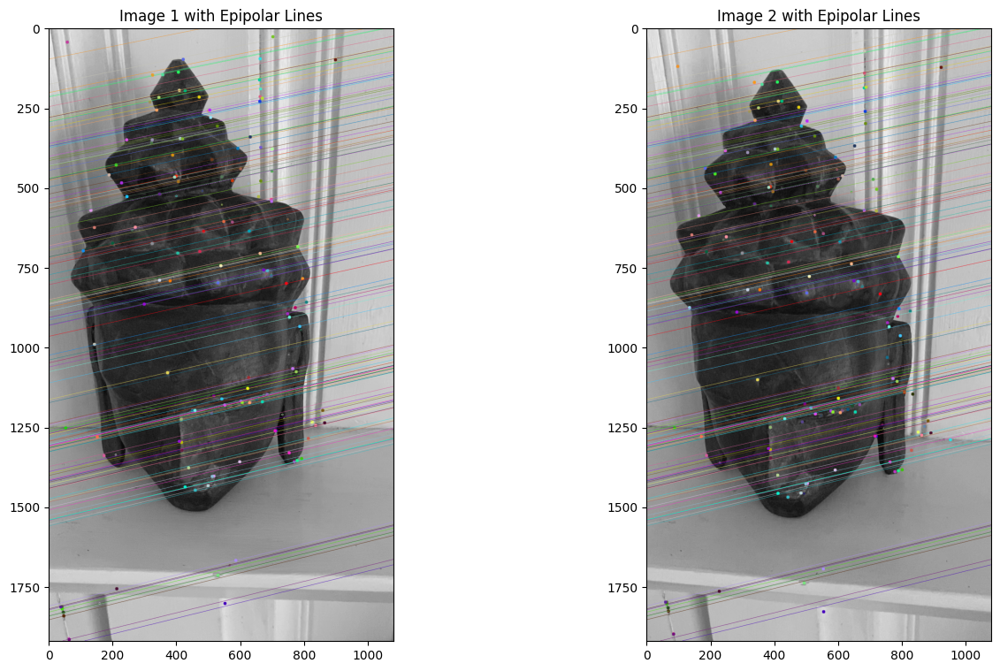

Image 15 and 16


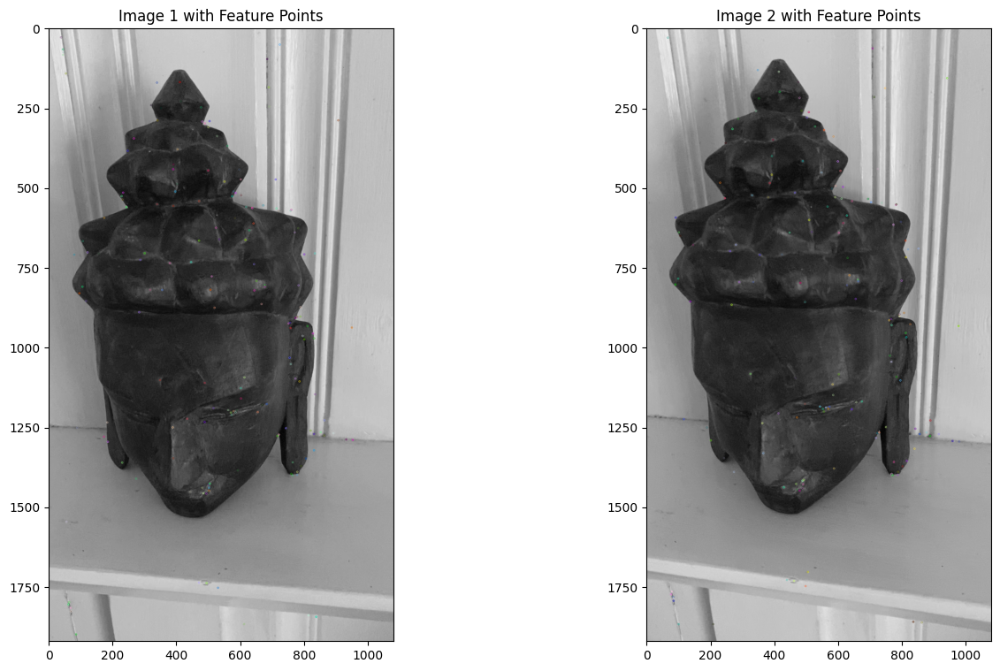

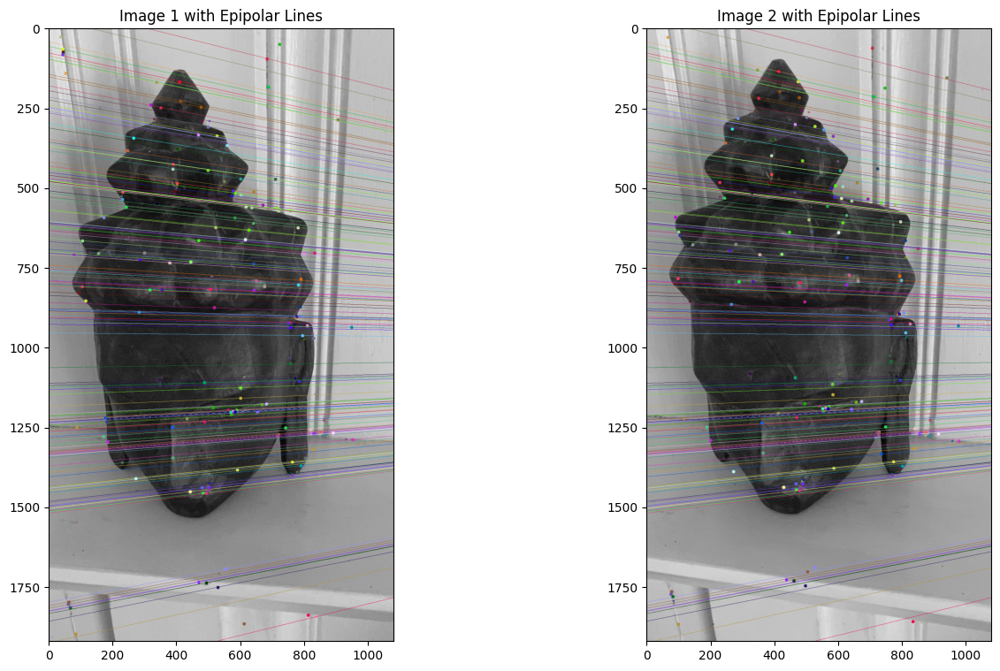

Image 16 and 17


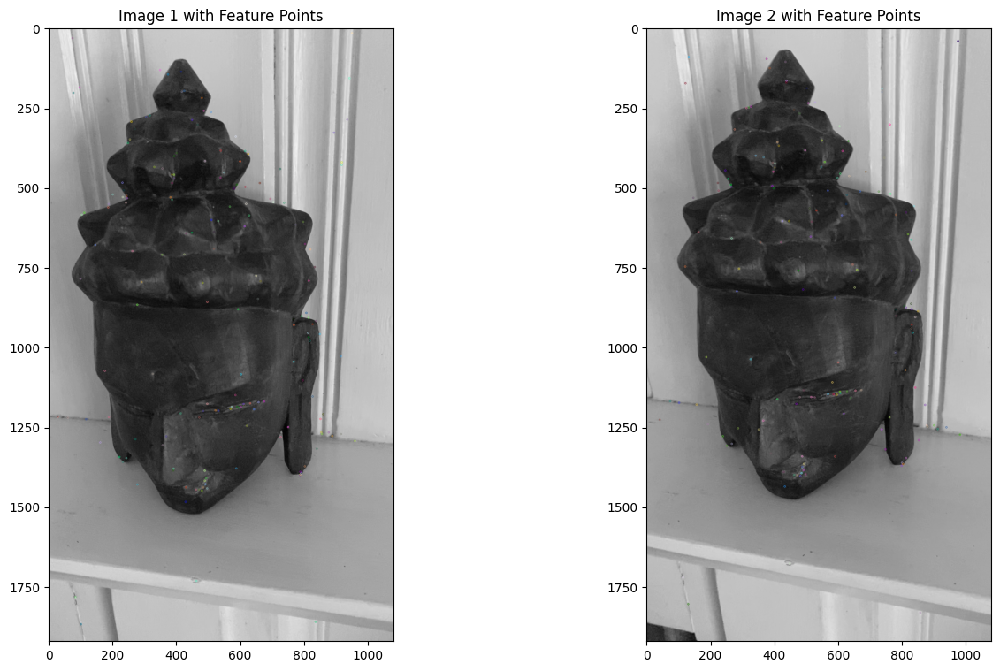

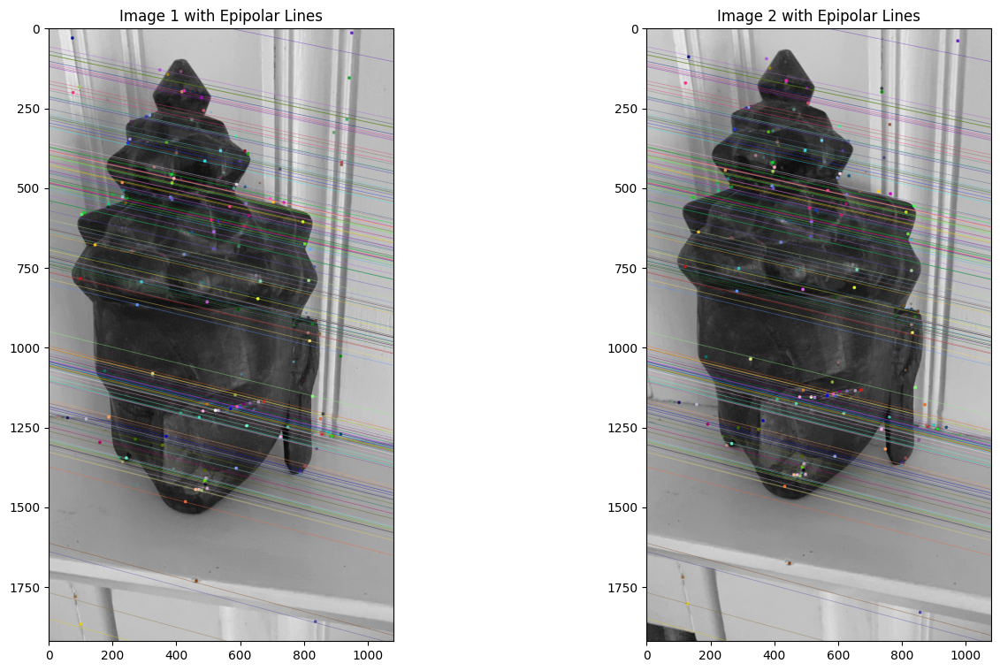

Image 17 and 18


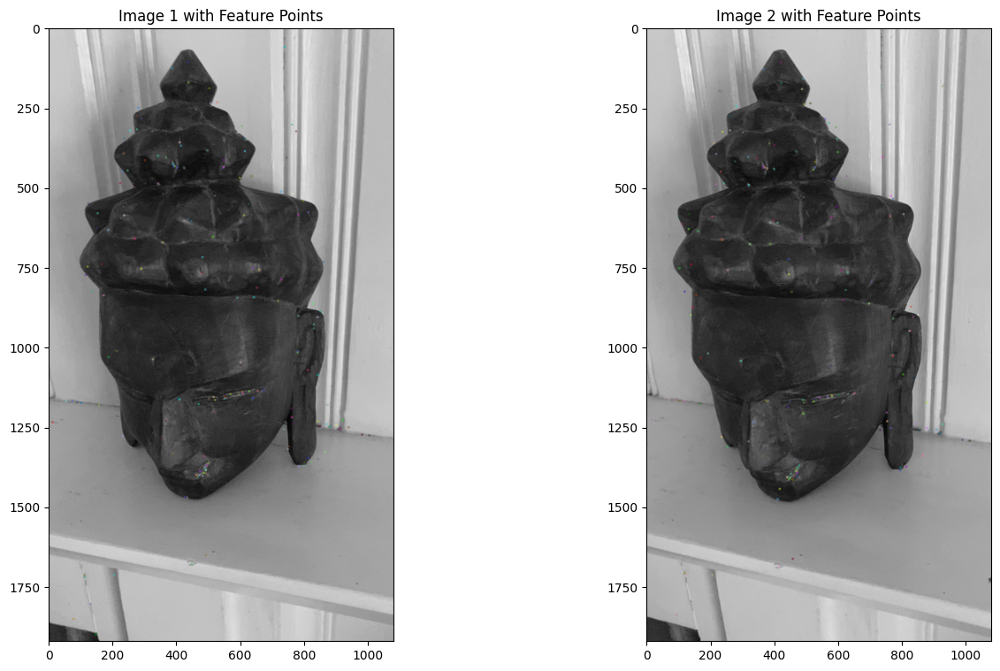

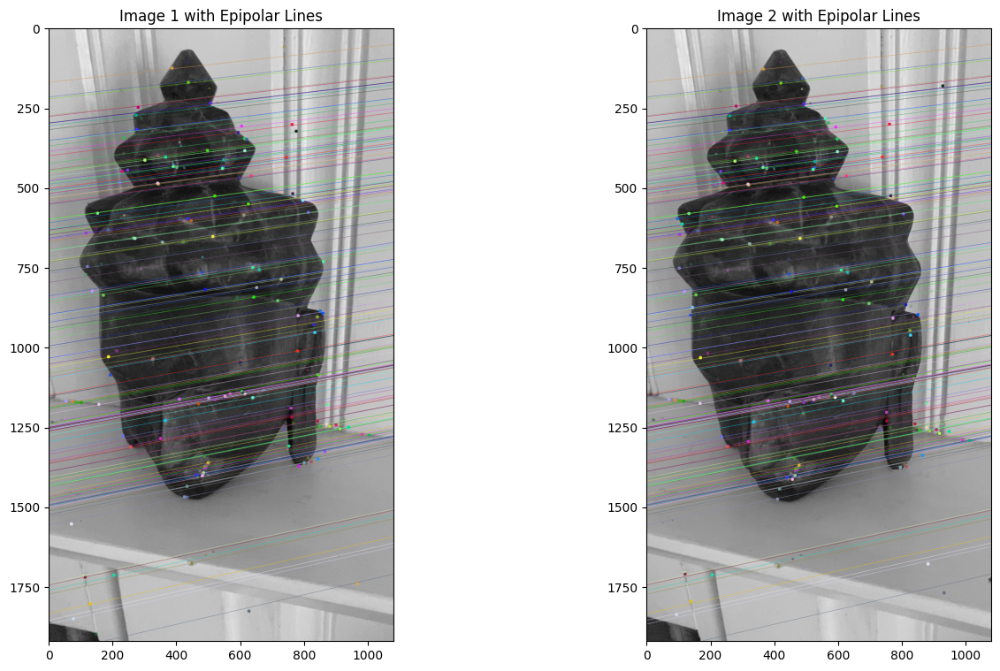

Image 18 and 19


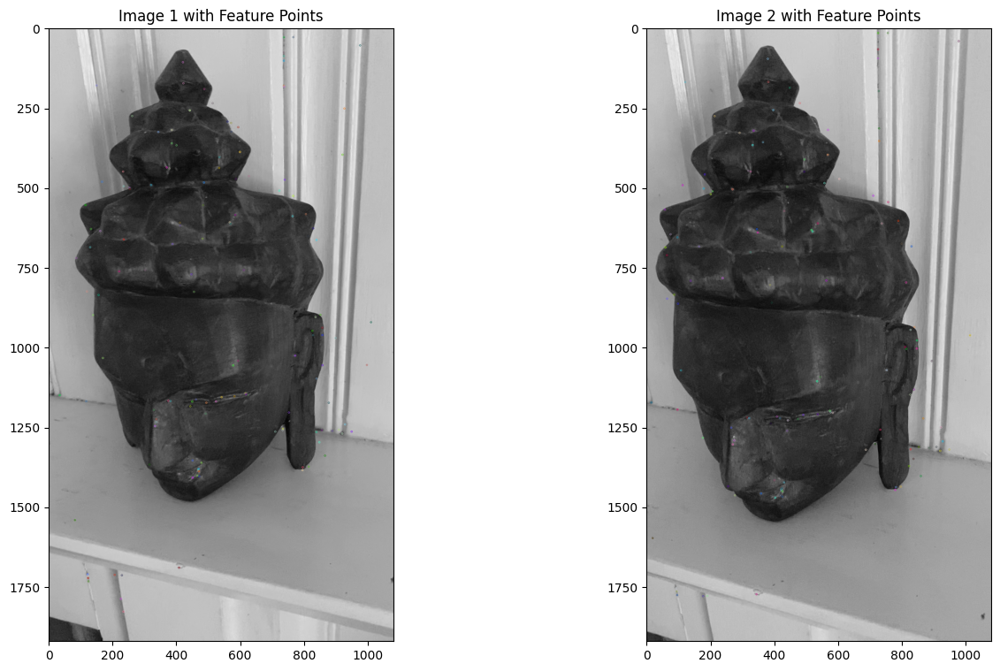

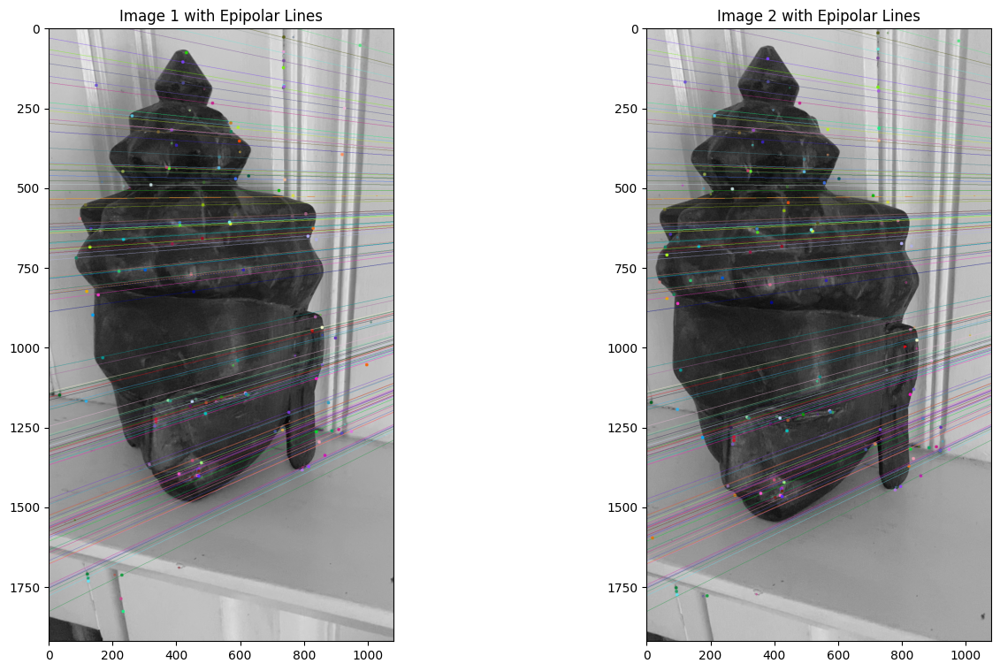

Image 19 and 20


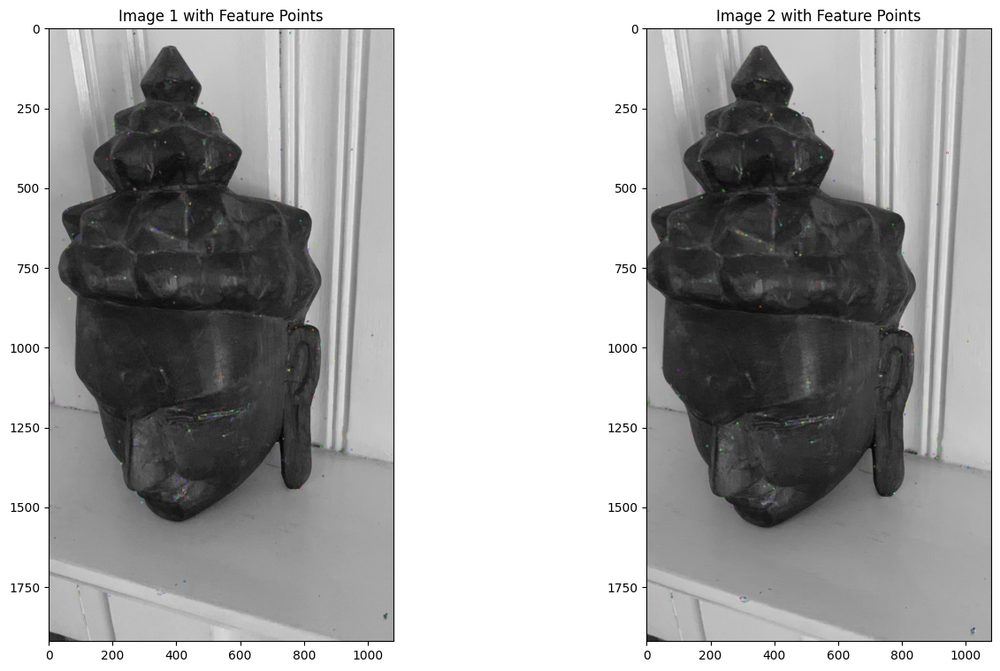

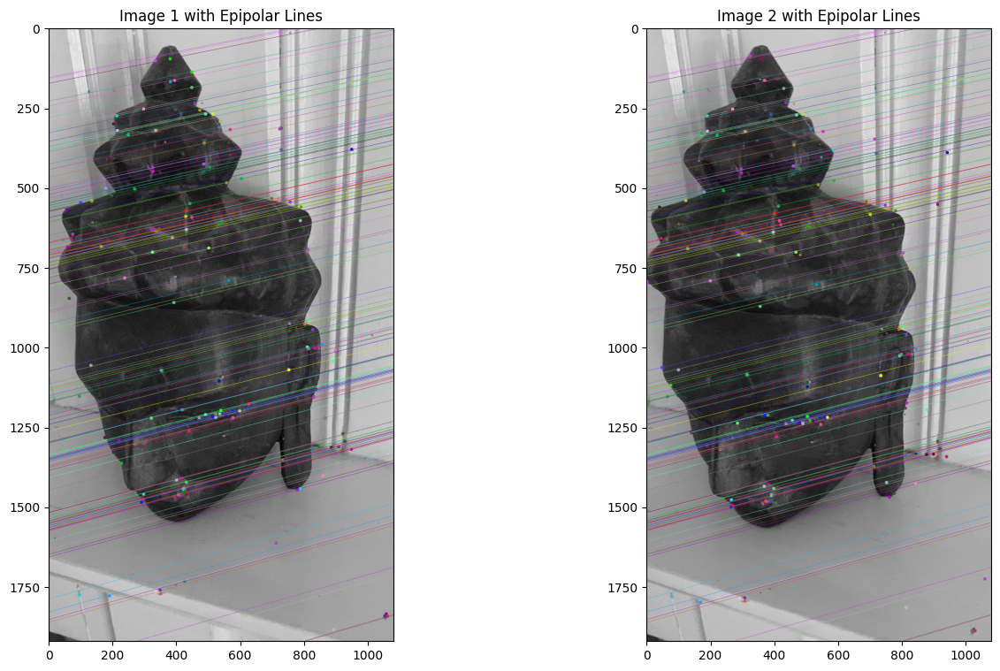

Image 20 and 21


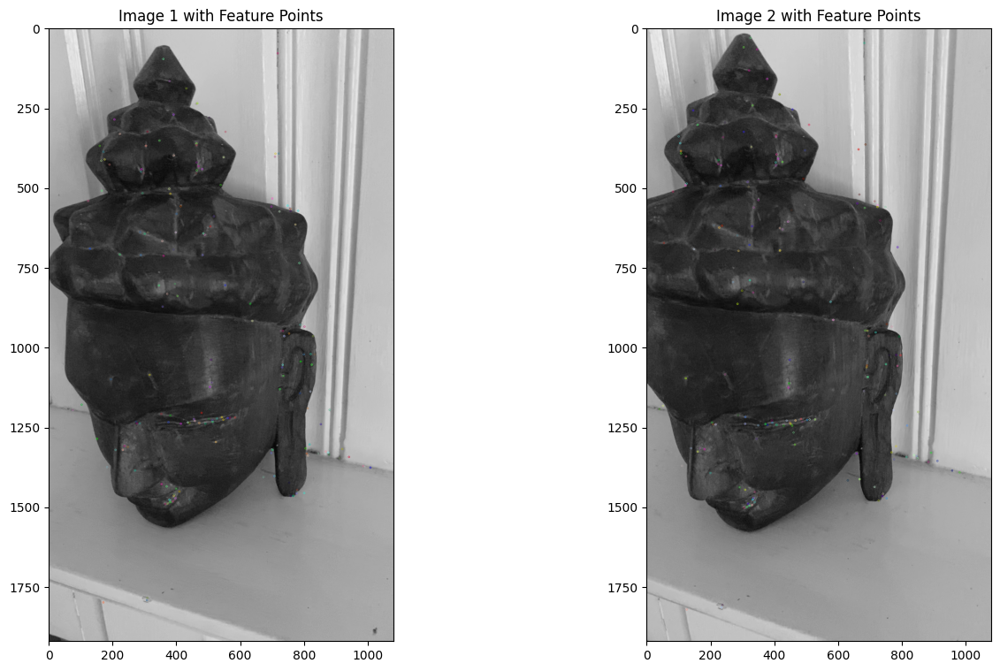

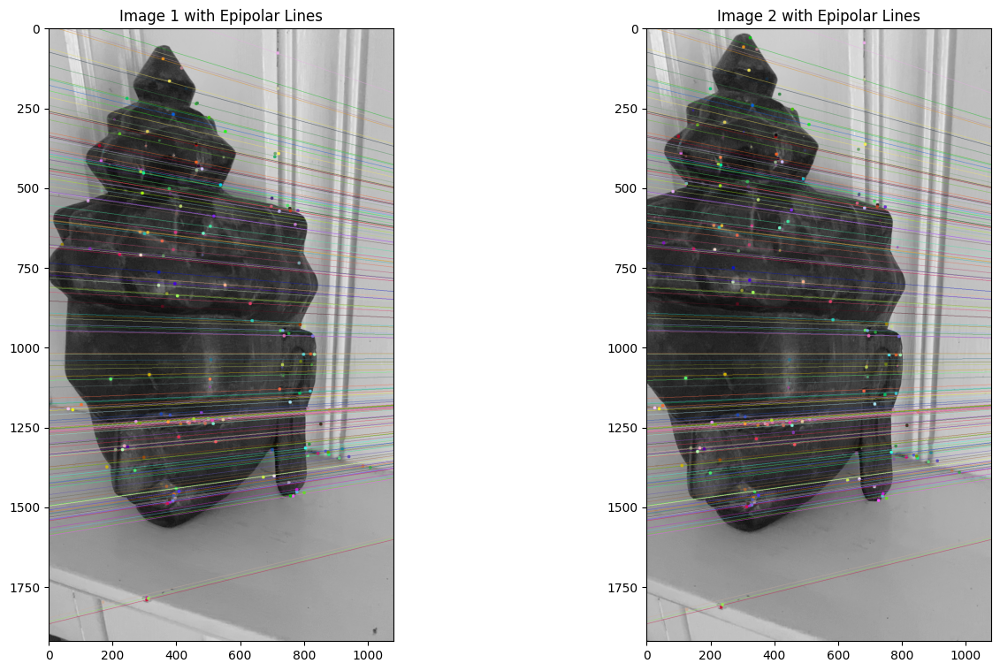

Image 21 and 22


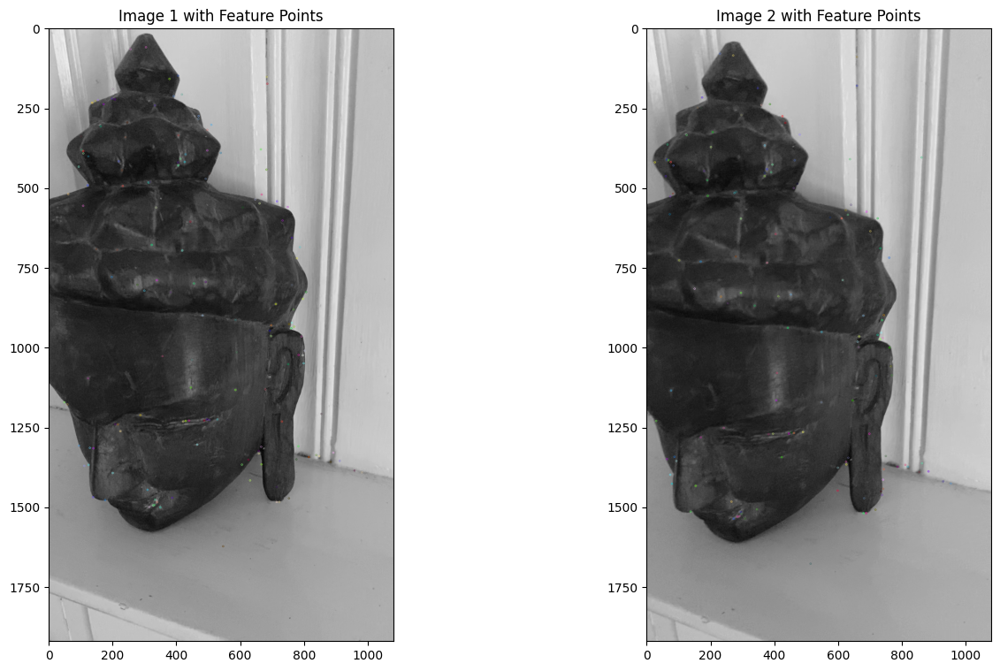

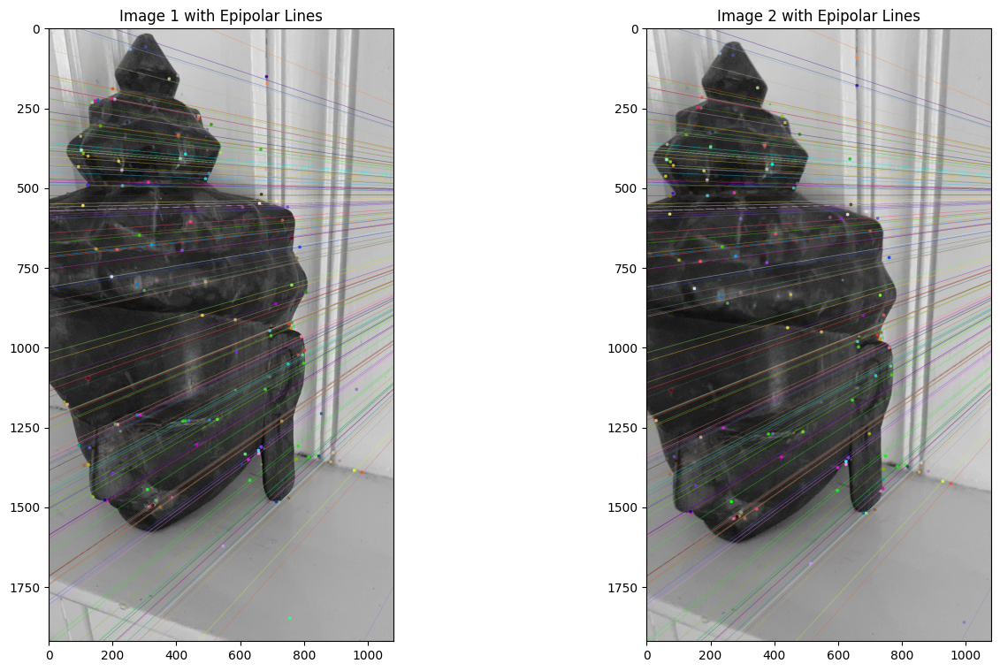

In [19]:
for i in range(1, N-2):
    print(f"Image {i} and {i+1}")
    image1, image2 = Images[i], Images[i+1]
    q1, q2 = match_and_visualize(image1, image2, i, i+1)
    E, q1, q2, mask = compute_essential_matrix(q1, q2)
    matched_2d_image1, matched_3d, matched_indices = extend_point_cloud(i, prev_keypoints, point_cloud, q1)
    matched_2d_image2 = q2[matched_indices]
    ran, rvec, t, _ = cv2.solvePnPRansac(matched_3d, matched_2d_image2, K, None)

    if ran:
        R, _ = cv2.Rodrigues(rvec) # converts rot vec to rot matrix
    tempTransformation = calculate_transformation_matrix(R, t)
    camera_positions.append(np.linalg.inv(tempTransformation))

    P1 = get_proj_matrix(camera_positions[i])
    P2 = get_proj_matrix(camera_positions[i+1])
    points3D, q1, q2 = triangulate_points(q1, q2, P1, P2)
    update_cloud(point_cloud, i, points3D, q1, q2)
    prev_keypoints = q2

#3D Reconstruction before Bundle Adjustment

In [20]:
def reconstrcution(camera_poses: list, cloud: np.ndarray):
    poses = np.array([np.array(camera_pose) for camera_pose in camera_poses])
    positions = [pose[:3, 3] for pose in poses]
    orientations = [pose[:3, :3] for pose in poses]

    fig = go.Figure()

    # Add Camera Poses as markers
    fig.add_trace(go.Scatter3d(
        x=[pos[0] for pos in positions],
        y=[pos[1] for pos in positions],
        z=[pos[2] for pos in positions],
        mode='markers',
        marker=dict(size=1, color='yellow'),
        name='Camera Poses'
    ))

    # Add Axes lines
    for i, (pos, orientation) in enumerate(zip(positions, orientations)):
        axis_len = 50
        axes_endpoints = [pos + orientation.dot(np.array([axis_len, 0, 0])),
                          pos + orientation.dot(np.array([0, axis_len, 0])),
                          pos + orientation.dot(np.array([0, 0, axis_len]))]

        axis_colors = ['red', 'green', 'blue']
        axis_names = ['X-axis', 'Y-axis', 'Z-axis']

        # Add each axis line
        for endpoint, color, name in zip(axes_endpoints, axis_colors, axis_names):
            fig.add_trace(go.Scatter3d(
                x=[pos[0], endpoint[0]],
                y=[pos[1], endpoint[1]],
                z=[pos[2], endpoint[2]],
                mode='lines',
                line=dict(color=color),
                name=name
            ))

    # Filter and add Pointcloud as markers
    mask = np.linalg.norm(cloud, axis=1) < 1000
    cloud = cloud[mask]

    fig.add_trace(go.Scatter3d(
        x=cloud[:, 0],
        y=cloud[:, 1],
        z=cloud[:, 2],
        mode='markers',
        marker=dict(size=1, color='brown'),
        name='Pointcloud'
    ))

    fig.update_layout(scene=dict(xaxis=dict(title='X axis'), yaxis=dict(title='Y axis'), zaxis=dict(title='Z axis')))
    fig.show()


In [21]:
pointcloud_old = copy.deepcopy(point_cloud)

In [27]:
reconstrcution(camera_positions, np.array([point.coords for point in pointcloud_old]))

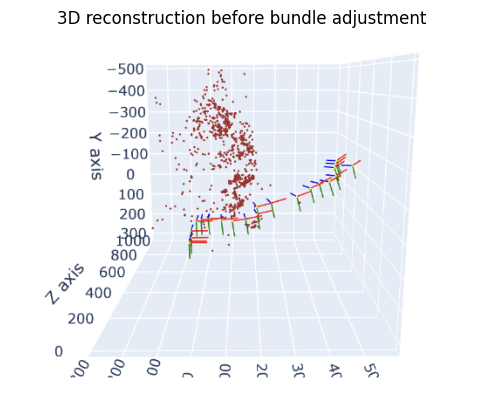

In [40]:
image = cv2.imread('/content/sample_data/buddha_3D_before_bundle.png')
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# Display the image with a title
plt.imshow(image)
plt.title('3D reconstruction before bundle adjustment')
plt.axis('off')  # Hide axes
plt.show()

#3D Reconstruction after Bundle Adjustment

In [36]:
h, w = Images[0].shape[:2]
f = 1300
K = np.array([[f, 0, w/2],
              [0, f, h/2],
              [0, 0, 1]], dtype=np.float32)
L = gtsam.symbol_shorthand.L
X = gtsam.symbol_shorthand.X
K = gtsam.Cal3_S2(K[0, 0], K[1, 1], 0.0, K[0, 2], K[1, 2])
measurement_noise = gtsam.noiseModel.Isotropic.Sigma(2, 10.0)
graph = gtsam.NonlinearFactorGraph()
pose_noise = gtsam.noiseModel.Diagonal.Sigmas(np.array([0.2, 0.2, 0.2, 0.1, 0.1, 0.1]))
factor = gtsam.PriorFactorPose3(X(0), gtsam.Pose3(camera_positions[0]), pose_noise)
graph.push_back(factor)

for j, point in enumerate(point_cloud):
    keys = list(point.origin.keys())
    for i in keys:
        measurement = point.origin[i]
        factor = gtsam.GenericProjectionFactorCal3_S2(measurement, measurement_noise, X(int(i)), L(j), K)
        graph.push_back(factor)
point_noise = gtsam.noiseModel.Isotropic.Sigma(3, 1)
factor = gtsam.PriorFactorPoint3(L(0), gtsam.Point3(point_cloud[0].coords), point_noise)
graph.push_back(factor)
initial_estimate = gtsam.Values()
for i in range(N-2):
    initial_estimate.insert(X(i), gtsam.Pose3(camera_positions[i]))
initial_estimate.insert(X(22), gtsam.Pose3(camera_positions[21]))
for j, point in enumerate(point_cloud):
    initial_estimate.insert(L(j), gtsam.Point3(point.coords))
params = gtsam.LevenbergMarquardtParams()
params.setVerbosityLM("SUMMARY")
optimizer = gtsam.LevenbergMarquardtOptimizer(graph, initial_estimate, params)
result = optimizer.optimize()


In [37]:
for i in range(N-2):
    camera_positions[i] = result.atPose3(X(i)).matrix()
for j, point in enumerate(point_cloud):
    point_cloud[j].coords = result.atPoint3(L(j))

In [38]:
reconstrcution(camera_positions, np.array([point.coords for point in point_cloud]))

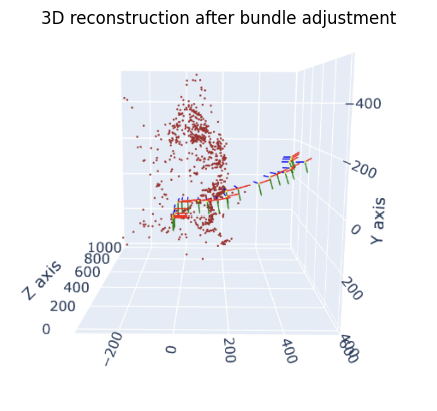

In [39]:
image = cv2.imread('/content/sample_data/buddha_3D_after_bundle.png')
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# Display the image with a title
plt.imshow(image)
plt.title('3D reconstruction after bundle adjustment')
plt.axis('off')  # Hide axes
plt.show()